<a href="https://colab.research.google.com/github/O00O297/CCA-AI/blob/master/VGG.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from __future__ import print_function, division

import torch
import torch.nn as nn
import torch.optim as optim
from torch.autograd import Variable
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
import os
import copy

import torch.utils.data as data

from PIL import Image
import os
import os.path
from os.path import isfile, join
from os import walk
from os import listdir

In [2]:
plt.ion()   # interactive mode

use_gpu = torch.cuda.is_available()
if use_gpu:
  print("Using CUDA")
else:
  print("CPU")

Using CUDA


In [4]:
def default_loader(path):
	return Image.open(path).convert('RGB')

def default_flist_reader(flist,path):
  imlist = []
  # path = "/content/drive/Shared drives/CCA-AI Slide/"
  with open(flist, 'r') as rf:
    for line in rf.readlines():
      impath, imlabel = line.strip().split()
      dir = path+ "/" +impath
      print(dir)
      sub_dir = [x[2] for x in walk(dir)][0]
      for img in sub_dir:
        img_path =impath + "/" + img
        imlist.append( (img_path, imlabel) )
    print(imlist)
  return imlist 

class ImageFilelist(data.Dataset):
  def __init__(self, root, flist, transform=None, target_transform=None,
               flist_reader=default_flist_reader, loader=default_loader):
    self.root   = root
    self.imlist = flist_reader(flist,root)
    self.transform = transform
    self.target_transform = target_transform
    self.loader = loader
  
  def __getitem__(self, index):
    impath, target = self.imlist[index]
    img = self.loader(os.path.join(self.root,impath))
    if self.transform is not None:
      img = self.transform(img)
    if self.target_transform is not None:
      target = self.target_transform(target)

    return img, target

  def __len__(self):
    return len(self.imlist)

In [6]:
train_loaders = torch.utils.data.DataLoader(
    ImageFilelist(root="/content/drive/Shared drives/CCA-AI Slide",
                  flist="/content/drive/Shared drives/CCA-AI Slide/filepath_train1.txt",
                  transform=transforms.Compose(
        [transforms.Resize(256),
        transforms.RandomResizedCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(), 
        ])),
        batch_size=8, shuffle=True,
        num_workers=4
    )
val_loaders = torch.utils.data.DataLoader(
    ImageFilelist(root="/content/drive/Shared drives/CCA-AI Slide",
                  flist="/content/drive/Shared drives/CCA-AI Slide/filepath_val1.txt",
                  transform=transforms.Compose(
        [transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(), 
        ])),
        batch_size=8, shuffle=True,
        num_workers=4
    )
test_loaders = torch.utils.data.DataLoader(
    ImageFilelist(root="/content/drive/Shared drives/CCA-AI Slide",
                  flist="/content/drive/Shared drives/CCA-AI Slide/filepath_test1.txt",
                  transform=transforms.Compose(
        [transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(), 
        ])),
        batch_size=8, shuffle=False,
        num_workers=4
    )

/content/drive/Shared drives/CCA-AI Slide/CCA/S63-01046/S63-1046-1A
/content/drive/Shared drives/CCA-AI Slide/CCA/S63-04300/S63-4300-1L
/content/drive/Shared drives/CCA-AI Slide/HCC/S63-00785/S63-785-1A
/content/drive/Shared drives/CCA-AI Slide/HCC/S63-00785/S63-785-2A
/content/drive/Shared drives/CCA-AI Slide/Other/S63-01256/S63-1256-1D
/content/drive/Shared drives/CCA-AI Slide/Other/S63-01256/S63-1256-1E
[('CCA/S63-01046/S63-1046-1A/S63-1046-1A-13_16.tiff', '0'), ('CCA/S63-01046/S63-1046-1A/S63-1046-1A-13_17.tiff', '0'), ('CCA/S63-01046/S63-1046-1A/S63-1046-1A-13_18.tiff', '0'), ('CCA/S63-01046/S63-1046-1A/S63-1046-1A-13_19.tiff', '0'), ('CCA/S63-01046/S63-1046-1A/S63-1046-1A-13_20.tiff', '0'), ('CCA/S63-01046/S63-1046-1A/S63-1046-1A-13_21.tiff', '0'), ('CCA/S63-01046/S63-1046-1A/S63-1046-1A-13_22.tiff', '0'), ('CCA/S63-01046/S63-1046-1A/S63-1046-1A-13_23.tiff', '0'), ('CCA/S63-01046/S63-1046-1A/S63-1046-1A-13_24.tiff', '0'), ('CCA/S63-01046/S63-1046-1A/S63-1046-1A-13_25.tiff', '0'),

In [ ]:
for inputs, labels in val_loaders:
    # use the above variables freely
    print(labels)

In [7]:
print(len(train_loaders))
print(len(val_loaders))
print(len(test_loaders))

948
485
629


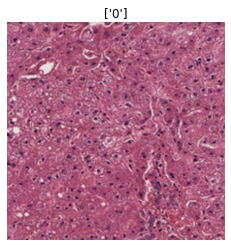

In [8]:
def imshow(inp, title=None):
    inp = inp.numpy().transpose((1, 2, 0))
    # plt.figure(figsize=(10, 10))
    plt.axis('off')
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

def show_databatch(inputs, classes):
    out = torchvision.utils.make_grid(inputs)
    imshow(out, title=[x for x in classes])

inputs, classes = next(iter(val_loaders))
show_databatch(inputs[0], classes[0])

In [19]:
def visualize_model(vgg, num_images=3):
    count = 0
    was_training = vgg.training
    
    # Set model for evaluation
    vgg.train(False)
    vgg.eval() 
    
    images_so_far = 0
    print (len(test_loaders))
    for i, (data) in enumerate(test_loaders):
        print(i)
        inputs, labels = data
        print ("input ",input)
        print ("labels ",labels)
        size = inputs.size()[0]
        
        inputs, labels = np.asarray(inputs, dtype = np.float32), np.asarray(labels, dtype = np.int64)
        inputs, labels = torch.from_numpy(inputs), torch.from_numpy(labels)

        if use_gpu:
            inputs, labels = Variable(inputs.cuda(), volatile=True), Variable(labels.cuda(), volatile=True)
        else:
            inputs, labels = Variable(inputs, volatile=True), Variable(labels, volatile=True)
        
        outputs = vgg(inputs)
        
        _, preds = torch.max(outputs.data, 1)
        predicted_labels = [preds[j] for j in range(inputs.size()[0])]
        
        print("Ground truth:")
        show_databatch(inputs.data.cpu(), labels.data.cpu())
        print("Prediction:")
        show_databatch(inputs.data.cpu(), predicted_labels)
        if labels.data.cpu() != predicted_labels:
          count +=1
        del inputs, labels, outputs, preds, predicted_labels
        torch.cuda.empty_cache()
        
        images_so_far += size
        if images_so_far >= num_images:
            break
        
    vgg.train(mode=was_training) # Revert model back to original training state
    return count

In [109]:
for i, (data) in enumerate(val_loaders):
  print(i)
  print(data[1])
  break

0
('0', '1', '1', '1', '1', '0', '0', '1', '0', '2', '1', '2', '2', '2', '2', '0', '1', '0', '1', '2', '2', '1', '0', '0', '0', '0', '1', '1', '1', '2', '1', '2', '0', '2', '0', '0', '2', '2', '2', '1', '2', '1', '2', '1', '2', '2', '2', '1', '0', '1', '2', '2', '0', '0', '2', '0', '1', '2', '0', '1', '0', '0', '1', '2')


In [25]:
def eval_model(vgg, criterion):
    since = time.time()
    avg_loss = 0
    avg_acc = 0
    loss_test = 0
    acc_test = 0
    
    test_batches = len(test_loaders)
    print("Evaluating model")
    print('-' * 10)
    
    for i, (data) in enumerate(test_loaders):
        if i % 100 == 0:
            print("\rTest batch {}/{}".format(i, test_batches), end='', flush=True)

        vgg.train(False)
        vgg.eval()
        inputs, labels = data
        inputs, labels = np.asarray(inputs, dtype = np.float32), np.asarray(labels, dtype = np.int64)
        inputs, labels = torch.from_numpy(inputs), torch.from_numpy(labels)
        
        if use_gpu:
            inputs, labels = Variable(inputs.cuda(), volatile=True), Variable(labels.cuda(), volatile=True)
        else:
            inputs, labels = Variable(inputs, volatile=True), Variable(labels, volatile=True)

        outputs = vgg(inputs)

        _, preds = torch.max(outputs.data, 1)
        loss = criterion(outputs, labels)

        # loss_test += loss.data[0]
        loss_test += loss.data
        acc_test += torch.sum(preds == labels.data)

        del inputs, labels, outputs, preds
        torch.cuda.empty_cache()
    
    
    avg_loss = loss_test / float(len(test_loaders))
    avg_acc = acc_test / float(len(test_loaders))
    
    elapsed_time = time.time() - since
    print()
    print("Evaluation completed in {:.0f}m {:.0f}s".format(elapsed_time // 60, elapsed_time % 60))
    print("Avg loss (test): {:.4f}".format(avg_loss))
    print("Avg acc (test): {:.4f}".format(avg_acc))
    print('-' * 10)

    return since, loss_test, acc_test

In [11]:
# vgg16 = models.vgg16_bn()
vgg16 = models.vgg16_bn(pretrained=False,num_classes=3)
# vgg16.load_state_dict(torch.load("/content/drive/Shared drives/CCA-AI Slide/Dataset/Model/VGG/vgg16_bn.pth"))

print(vgg16.classifier[6].out_features) # 1000 


# Freeze training for all layers
for param in vgg16.features.parameters():
    param.require_grad = False

# Newly created modules have require_grad=True by default
num_features = vgg16.classifier[6].in_features
features = list(vgg16.classifier.children())[:-1] # Remove last layer
features.extend([nn.Linear(num_features, 3)]) # Add our layer with 4 outputs
vgg16.classifier = nn.Sequential(*features) # Replace the model classifier
print(vgg16)

3
VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): ReLU(inplace=True)
    (13): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (14): Conv2d(128, 2

In [12]:
if use_gpu:
    vgg16.cuda() #.cuda() will move everything to the GPU side
    
criterion = nn.CrossEntropyLoss()

optimizer_ft = optim.SGD(vgg16.parameters(), lr=0.001, momentum=0.9)
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

In [47]:
print(criterion)

print("Test before training")
since, loss_test, acc_test = eval_model(vgg16, criterion)

CrossEntropyLoss()
Test before training
Evaluating model
----------
Test batch 0/5266

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:24: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.


Test batch 5200/5266
Evaluation completed in 131m 59s
Avg loss (test): 1.0978
Avg acc (test): 2.8145
----------


In [14]:
def train_model(vgg, criterion, optimizer, scheduler, num_epochs=10):
    use_gpu = torch.cuda.is_available()
    since = time.time()
    best_model_wts = copy.deepcopy(vgg.state_dict())
    best_acc = 0.0
    
    avg_loss = 0
    avg_acc = 0
    avg_loss_val = 0
    avg_acc_val = 0
    
    train_batches = len(train_loaders)
    val_batches = len(val_loaders)
    
    for epoch in range(num_epochs):
        print("Epoch {}/{}".format(epoch, num_epochs))
        print('-' * 10)
        
        loss_train = 0
        loss_val = 0
        acc_train = 0
        acc_val = 0
        
        vgg.train(True)
        
        for i, (data) in enumerate(train_loaders):
            if i % 100 == 0:
                print("\rTraining batch {}/{}".format(i, train_batches / 2), end='', flush=True)
                
            # Use half training dataset
            if i >= train_batches / 2:
                break
                
            inputs, labels = data
            inputs, labels = np.asarray(inputs, dtype = np.float32), np.asarray(labels, dtype = np.int64)
            inputs, labels = torch.from_numpy(inputs), torch.from_numpy(labels)
            
            if use_gpu:
                inputs, labels = Variable(inputs.cuda()), Variable(labels.cuda())
            else:
                inputs, labels = Variable(inputs), Variable(labels)
            
            optimizer.zero_grad()
            
            outputs = vgg(inputs)
            
            _, preds = torch.max(outputs.data, 1)
            loss = criterion(outputs, labels)
            
            loss.backward()
            optimizer.step()
            
            # loss_train += loss.data[0]
            loss_train += loss.data
            acc_train += torch.sum(preds == labels.data)
            
            del inputs, labels, outputs, preds
            torch.cuda.empty_cache()
        
        print()
        # * 2 as we only used half of the dataset
        avg_loss = loss_train * 2 / len(train_loaders)
        avg_acc = acc_train * 2 / len(train_loaders)
        
        vgg.train(False)
        vgg.eval()
            
        for i, (data) in enumerate(val_loaders):
            if i % 100 == 0:
                print("\rValidation batch {}/{}".format(i, val_batches), end='', flush=True)
                # print("Val")
                
            inputs, labels = data
            inputs, labels = np.asarray(inputs, dtype = np.float32), np.asarray(labels, dtype = np.int64)
            inputs, labels = torch.from_numpy(inputs), torch.from_numpy(labels)
            
            if use_gpu:
                inputs, labels = Variable(inputs.cuda(), volatile=True), Variable(labels.cuda(), volatile=True)
            else:
                inputs, labels = Variable(inputs, volatile=True), Variable(labels, volatile=True)
            
            optimizer.zero_grad()
            
            outputs = vgg(inputs)
            
            _, preds = torch.max(outputs.data, 1)
            loss = criterion(outputs, labels)
            
            # loss_val += loss.data[0]
            loss_val += loss.data
            acc_val += torch.sum(preds == labels.data)
            
            del inputs, labels, outputs, preds
            torch.cuda.empty_cache()
        
        avg_loss_val = loss_val / float(len(train_loaders))
        avg_acc_val = acc_val / float(len(val_loaders))
        
        print()
        print("Epoch {} result: ".format(epoch))
        print("Avg loss (train): {:.4f}".format(avg_loss))
        print("Avg acc (train): {:.4f}".format(avg_acc))
        print("Avg loss (val): {:.4f}".format(avg_loss_val))
        print("Avg acc (val): {:.4f}".format(avg_acc_val))
        print('-' * 10)
        print()
        
        if avg_acc_val > best_acc:
            best_acc = avg_acc_val
            best_model_wts = copy.deepcopy(vgg.state_dict())
        
    elapsed_time = time.time() - since
    print()
    print("Training completed in {:.0f}m {:.0f}s".format(elapsed_time // 60, elapsed_time % 60))
    print("Best acc: {:.4f}".format(best_acc))
    
    vgg.load_state_dict(best_model_wts)
    return vgg

In [15]:
vgg16 = train_model(vgg16, criterion, optimizer_ft, exp_lr_scheduler, num_epochs=5)
status = torch.save(vgg16.state_dict(), '/content/drive/Shared drives/CCA-AI Slide/Slide_preprocess/model3class.pt')
print(status)

Epoch 0/5
----------
Training batch 400/474.0
Validation batch 0/485

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:78: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.


Validation batch 400/485
Epoch 0 result: 
Avg loss (train): 1.3061
Avg acc (train): 4.5485
Avg loss (val): 0.5500
Avg acc (val): 3.5959
----------

Epoch 1/5
----------
Training batch 400/474.0
Validation batch 400/485
Epoch 1 result: 
Avg loss (train): 0.8362
Avg acc (train): 5.2300
Avg loss (val): 0.5758
Avg acc (val): 3.9196
----------

Epoch 2/5
----------
Training batch 400/474.0
Validation batch 400/485
Epoch 2 result: 
Avg loss (train): 0.7607
Avg acc (train): 5.4114
Avg loss (val): 0.5519
Avg acc (val): 3.9155
----------

Epoch 3/5
----------
Training batch 400/474.0
Validation batch 400/485
Epoch 3 result: 
Avg loss (train): 0.7161
Avg acc (train): 5.5675
Avg loss (val): 0.6310
Avg acc (val): 3.2990
----------

Epoch 4/5
----------
Training batch 400/474.0
Validation batch 400/485
Epoch 4 result: 
Avg loss (train): 0.6659
Avg acc (train): 5.7553
Avg loss (val): 0.5670
Avg acc (val): 3.2598
----------


Training completed in 32m 17s
Best acc: 3.9196
None


629
0
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:22: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.


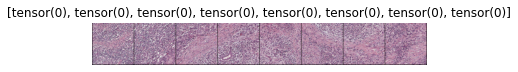

Prediction:


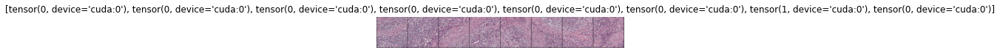

1
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


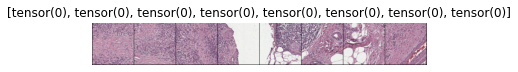

Prediction:


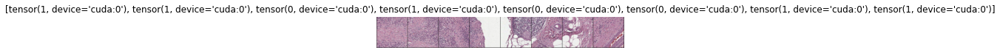

2
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


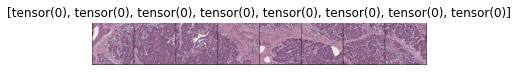

Prediction:


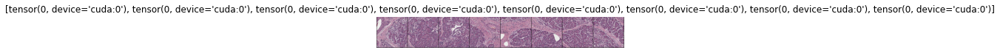

3
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


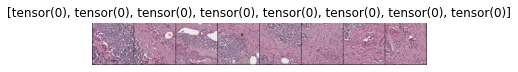

Prediction:


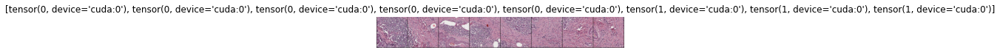

4
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


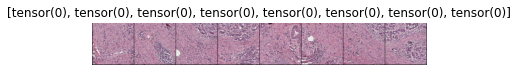

Prediction:


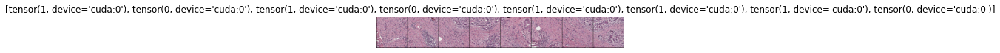

5
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


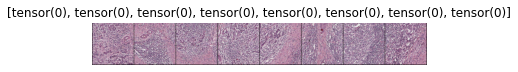

Prediction:


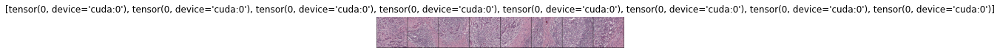

6
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


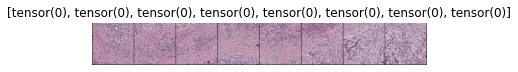

Prediction:


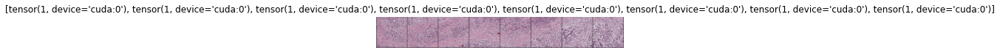

7
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


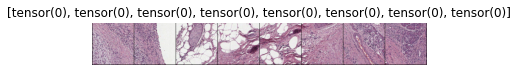

Prediction:


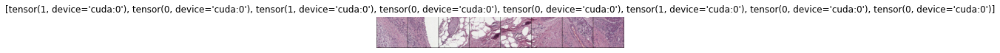

8
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


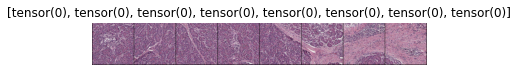

Prediction:


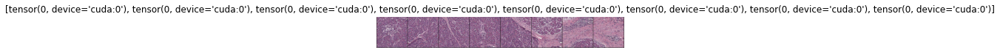

9
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


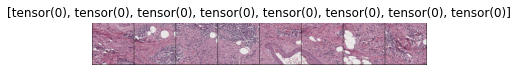

Prediction:


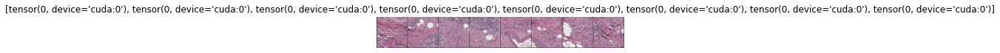

10
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


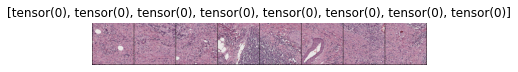

Prediction:


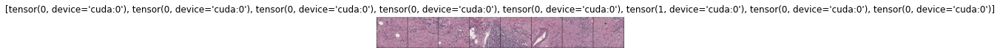

11
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


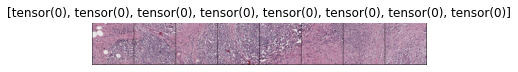

Prediction:


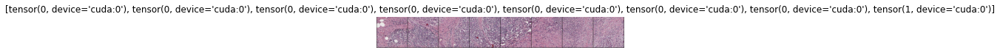

12
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


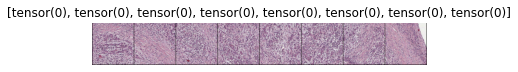

Prediction:


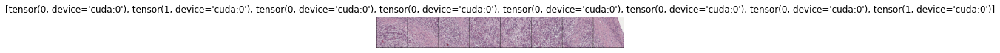

13
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


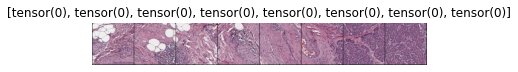

Prediction:


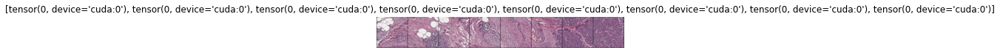

14
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


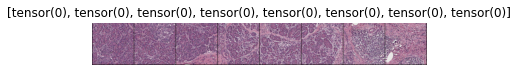

Prediction:


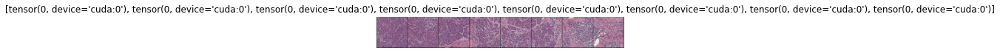

15
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


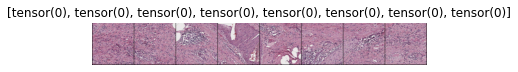

Prediction:


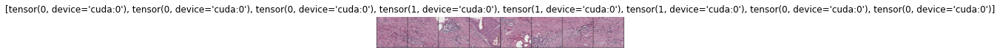

16
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


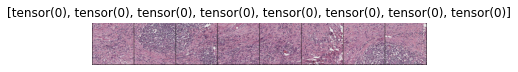

Prediction:


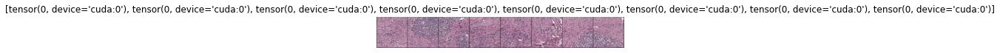

17
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


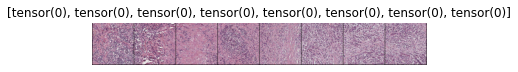

Prediction:


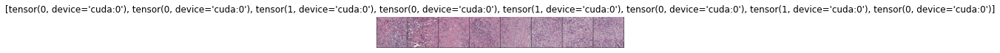

18
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


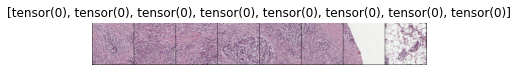

Prediction:


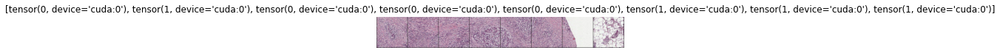

19
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


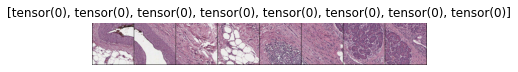

Prediction:


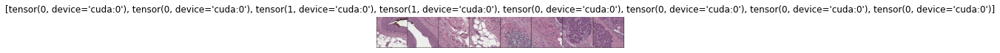

20
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


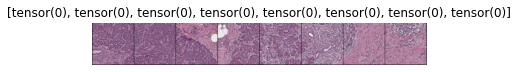

Prediction:


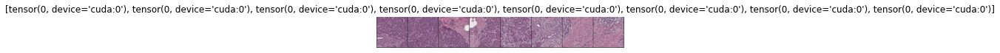

21
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


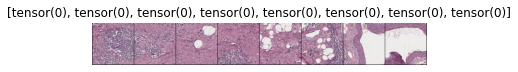

Prediction:


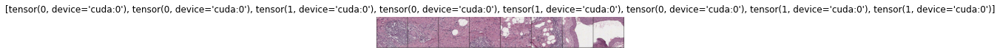

22
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


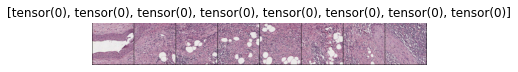

Prediction:


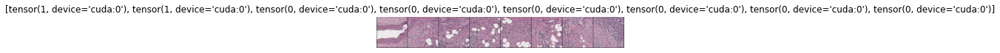

23
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


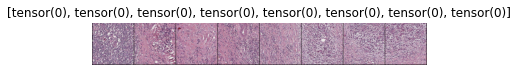

Prediction:


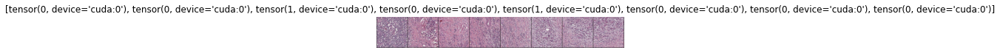

24
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


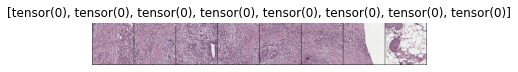

Prediction:


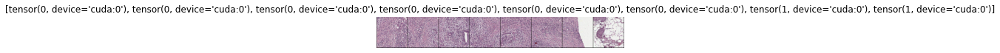

25
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


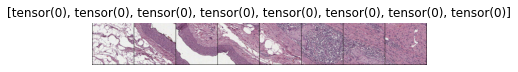

Prediction:


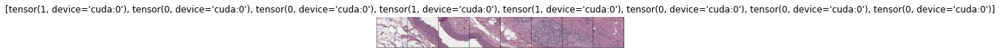

26
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


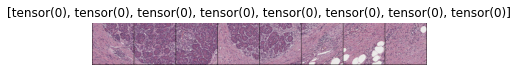

Prediction:


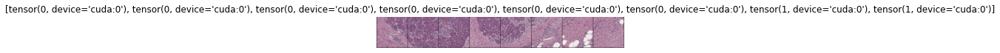

27
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


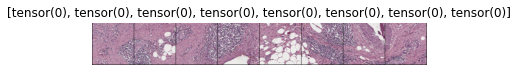

Prediction:


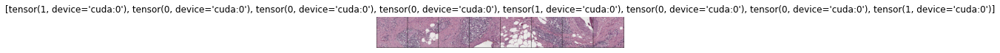

28
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


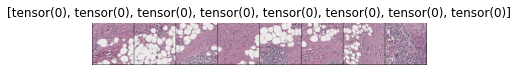

Prediction:


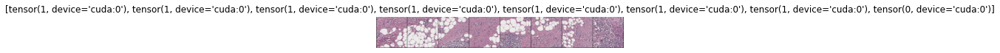

29
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


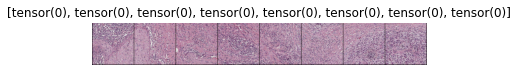

Prediction:


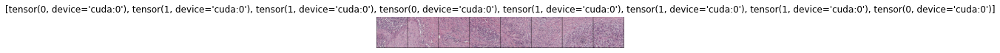

30
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


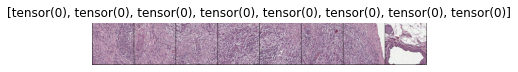

Prediction:


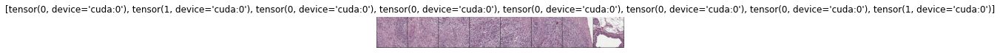

31
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


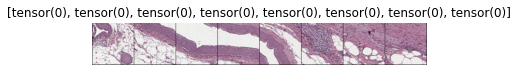

Prediction:


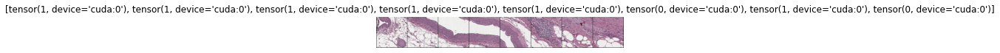

32
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


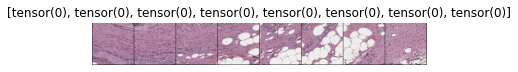

Prediction:


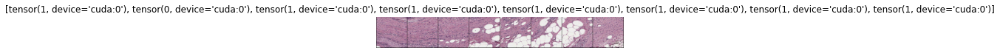

33
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


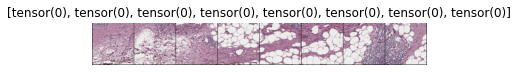

Prediction:


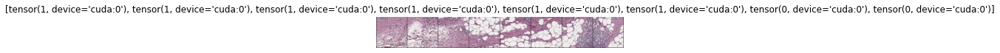

34
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


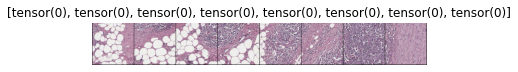

Prediction:


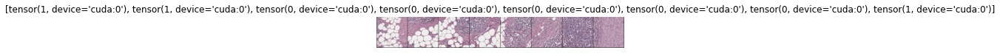

35
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


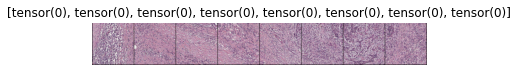

Prediction:


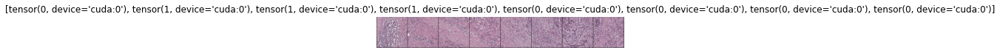

36
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


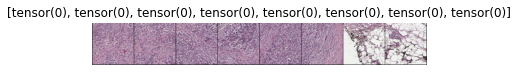

Prediction:


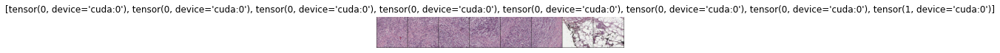

37
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


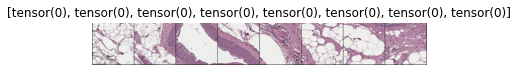

Prediction:


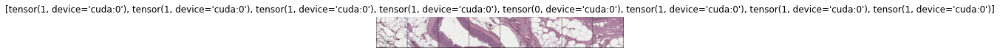

38
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


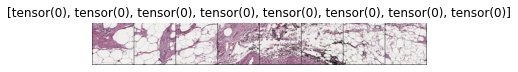

Prediction:


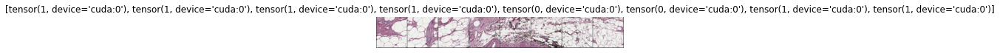

39
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


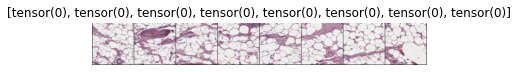

Prediction:


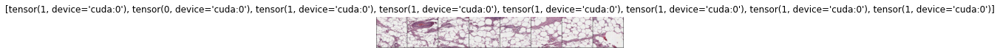

40
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


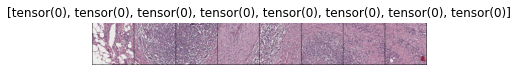

Prediction:


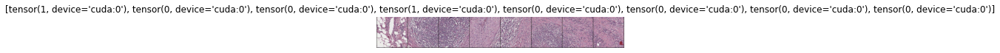

41
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


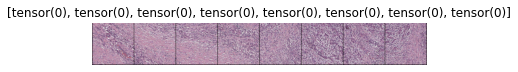

Prediction:


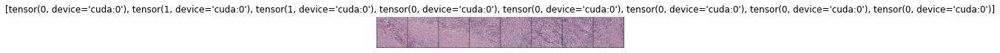

42
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


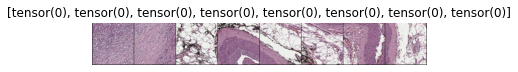

Prediction:


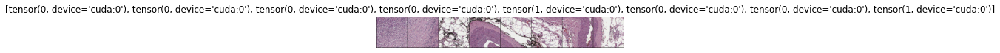

43
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


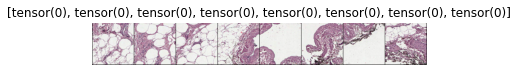

Prediction:


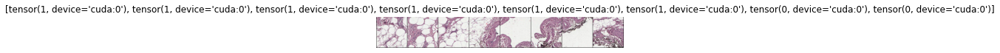

44
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


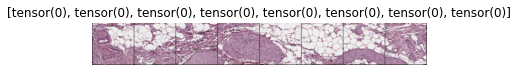

Prediction:


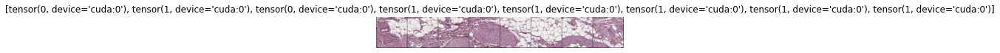

45
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


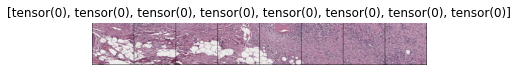

Prediction:


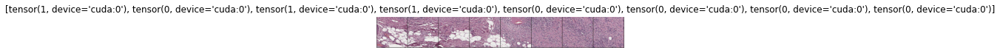

46
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


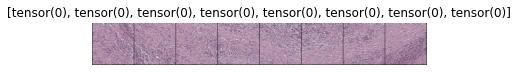

Prediction:


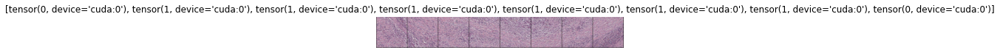

47
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


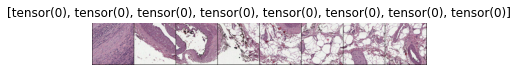

Prediction:


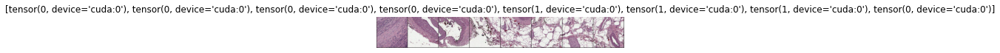

48
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


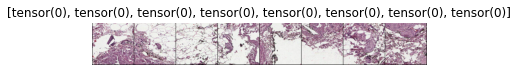

Prediction:


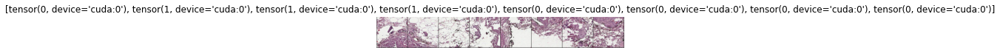

49
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


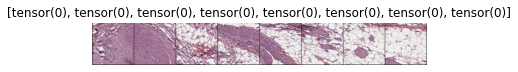

Prediction:


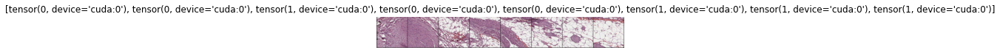

50
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


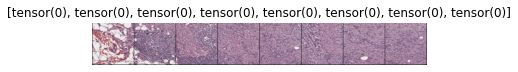

Prediction:


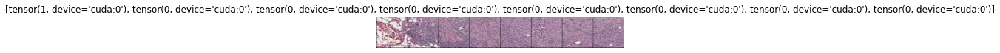

51
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


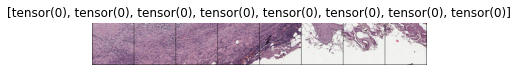

Prediction:


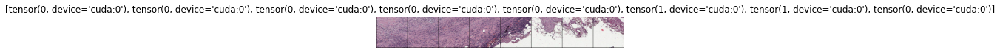

52
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


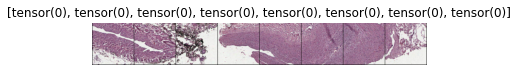

Prediction:


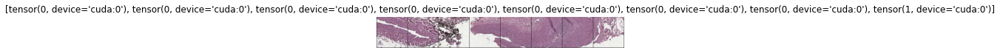

53
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


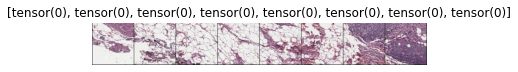

Prediction:


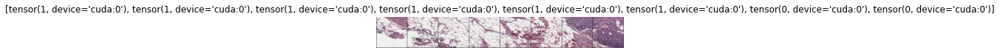

54
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


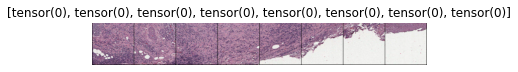

Prediction:


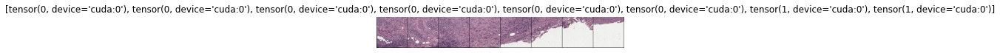

55
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


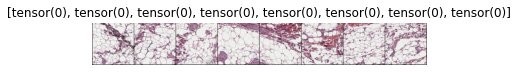

Prediction:


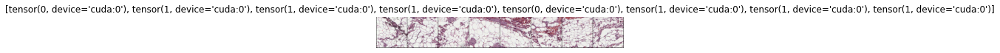

56
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


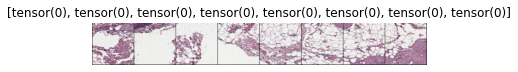

Prediction:


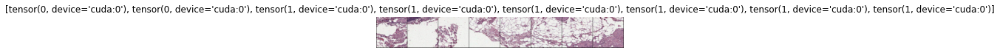

57
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


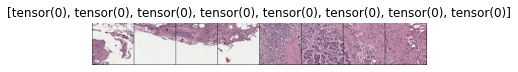

Prediction:


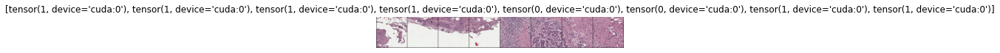

58
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


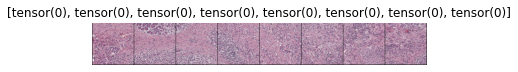

Prediction:


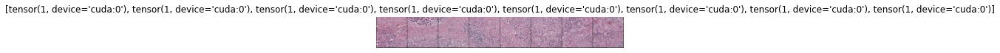

59
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


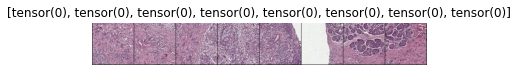

Prediction:


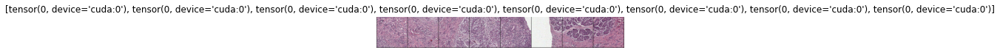

60
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


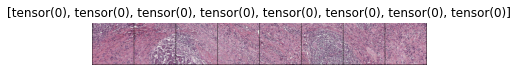

Prediction:


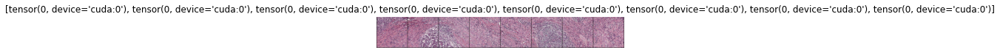

61
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


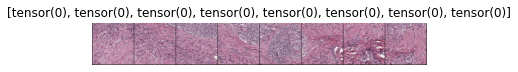

Prediction:


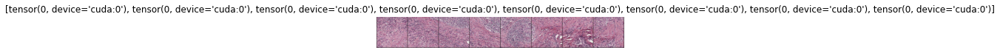

62
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


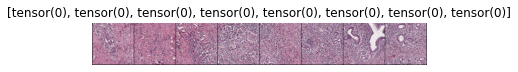

Prediction:


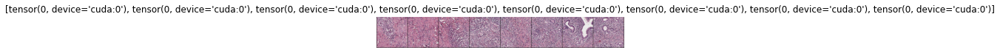

63
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


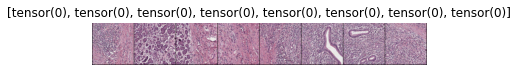

Prediction:


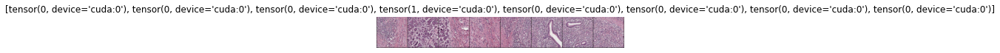

64
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


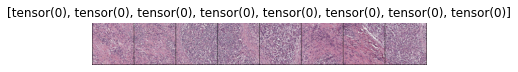

Prediction:


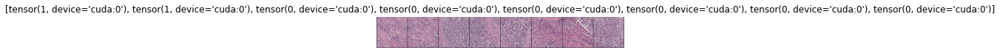

65
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


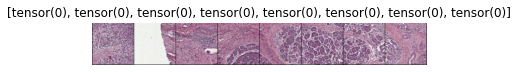

Prediction:


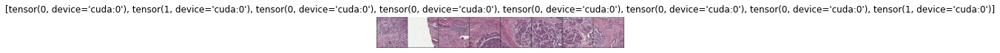

66
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


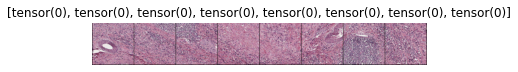

Prediction:


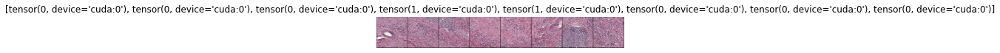

67
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


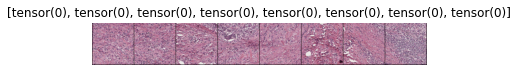

Prediction:


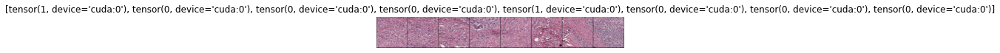

68
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


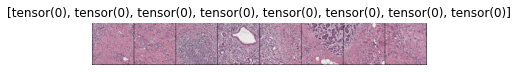

Prediction:


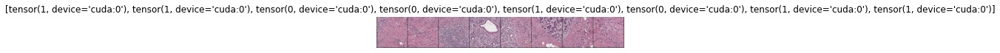

69
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


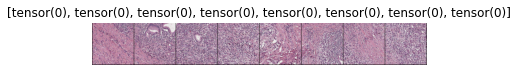

Prediction:


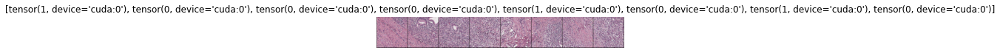

70
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


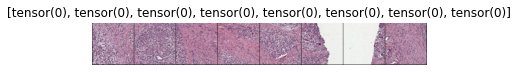

Prediction:


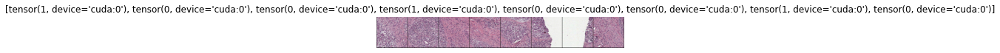

71
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


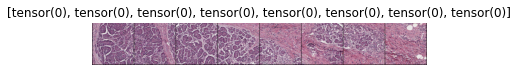

Prediction:


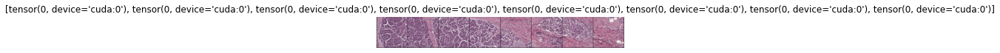

72
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


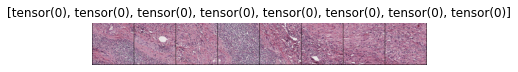

Prediction:


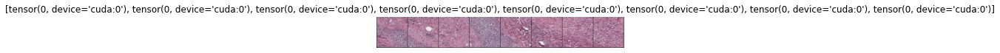

73
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


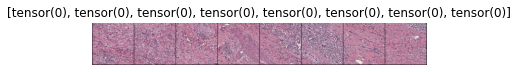

Prediction:


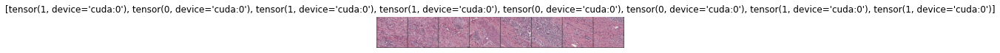

74
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


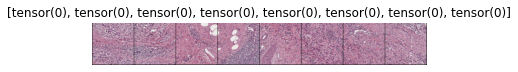

Prediction:


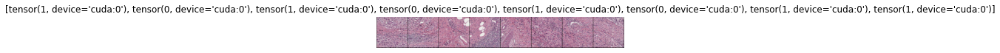

75
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


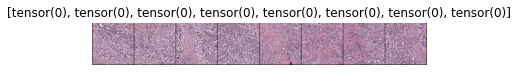

Prediction:


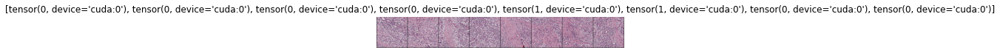

76
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


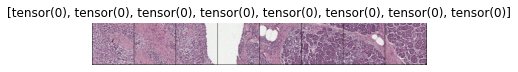

Prediction:


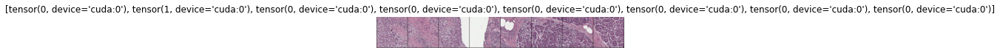

77
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


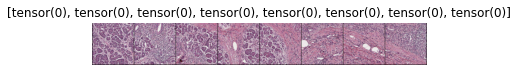

Prediction:


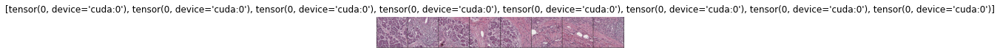

78
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


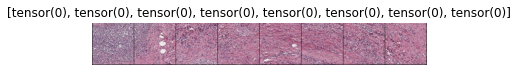

Prediction:


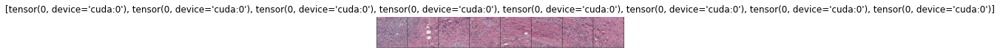

79
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


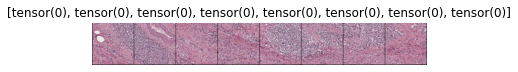

Prediction:


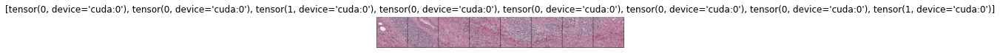

80
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


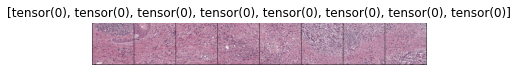

Prediction:


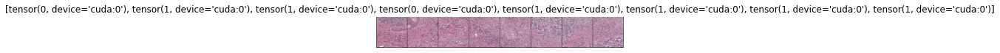

81
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


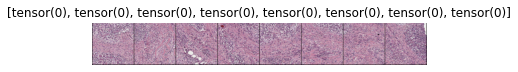

Prediction:


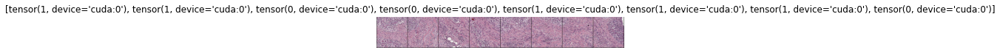

82
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


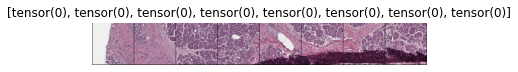

Prediction:


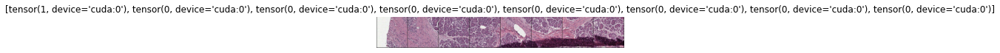

83
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


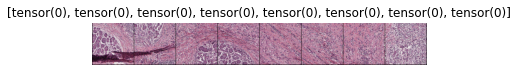

Prediction:


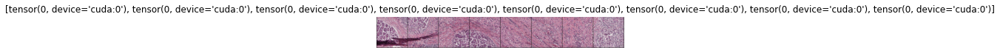

84
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


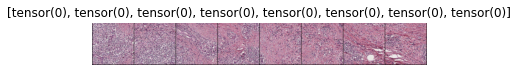

Prediction:


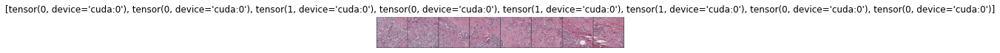

85
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


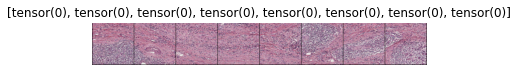

Prediction:


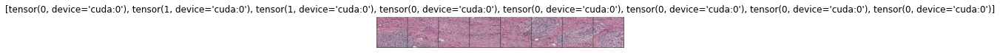

86
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


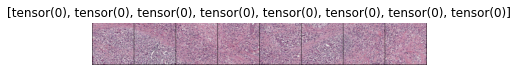

Prediction:


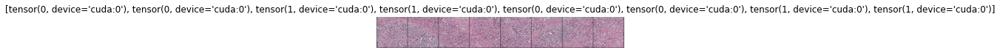

87
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


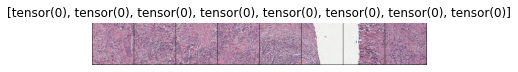

Prediction:


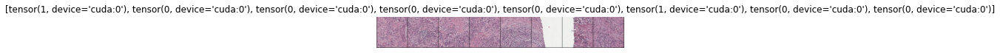

88
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


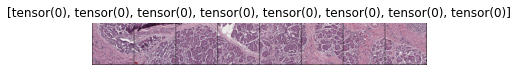

Prediction:


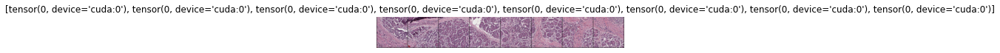

89
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


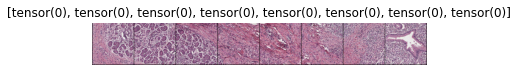

Prediction:


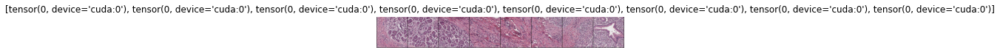

90
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


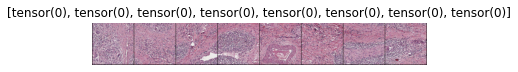

Prediction:


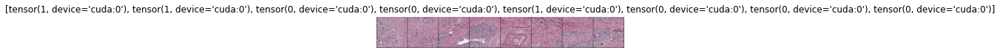

91
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


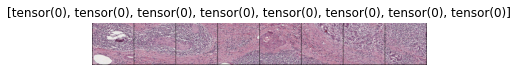

Prediction:


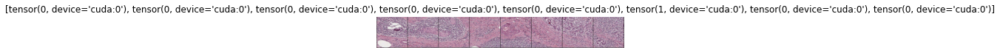

92
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


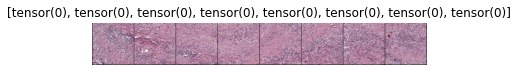

Prediction:


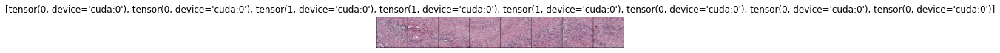

93
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


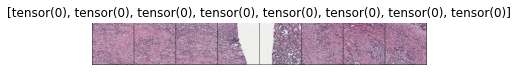

Prediction:


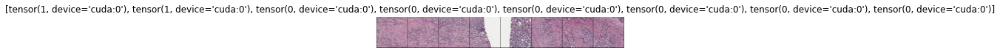

94
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


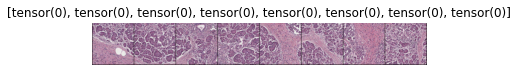

Prediction:


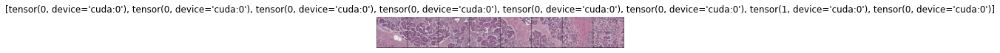

95
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


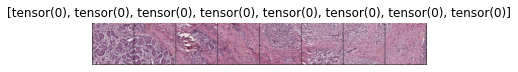

Prediction:


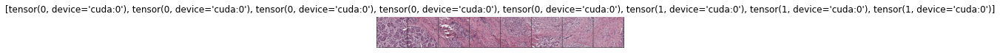

96
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


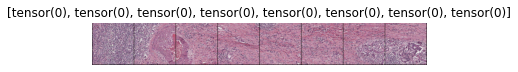

Prediction:


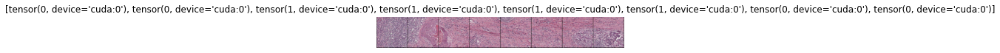

97
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


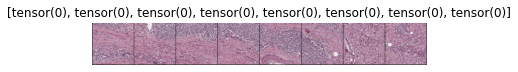

Prediction:


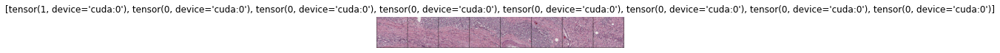

98
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


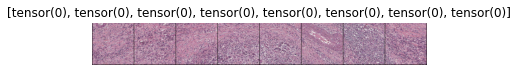

Prediction:


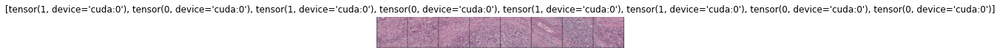

99
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


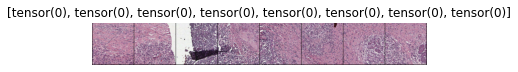

Prediction:


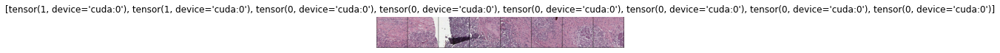

100
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


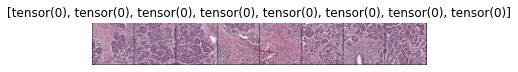

Prediction:


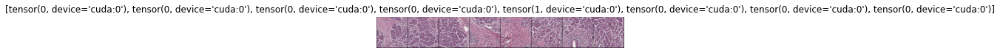

101
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


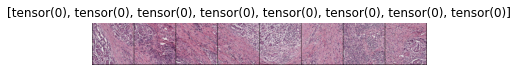

Prediction:


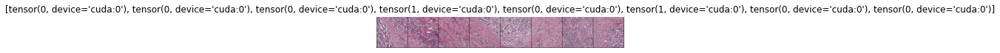

102
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


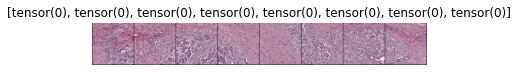

Prediction:


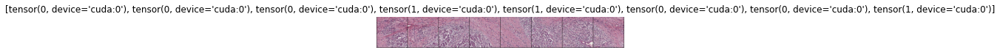

103
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


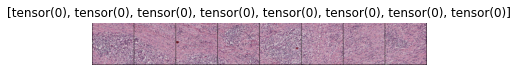

Prediction:


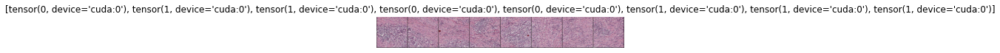

104
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


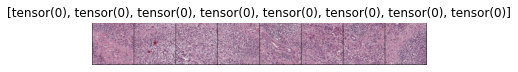

Prediction:


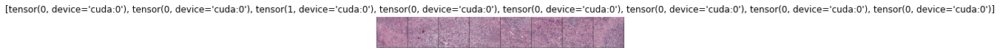

105
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


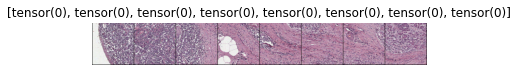

Prediction:


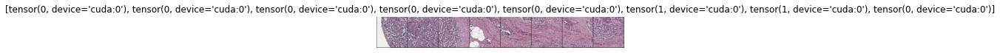

106
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


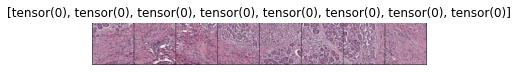

Prediction:


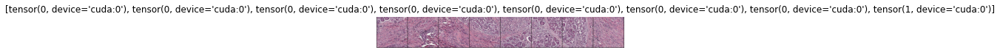

107
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


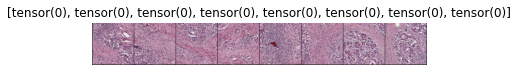

Prediction:


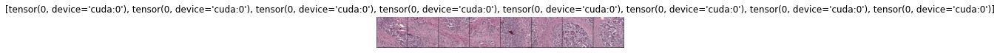

108
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


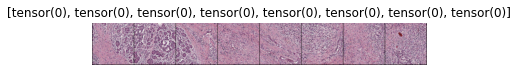

Prediction:


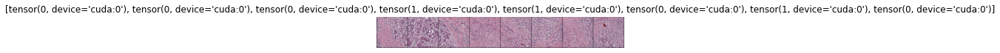

109
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


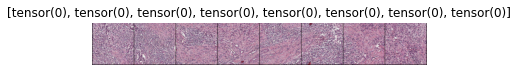

Prediction:


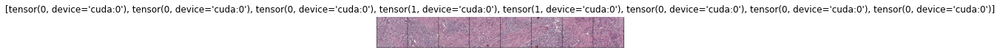

110
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


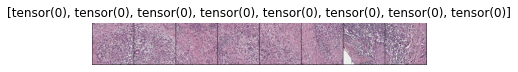

Prediction:


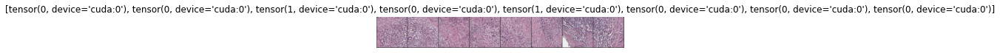

111
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


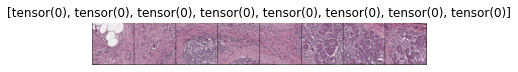

Prediction:


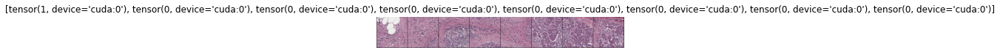

112
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


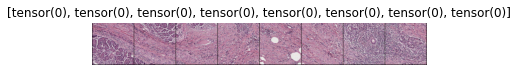

Prediction:


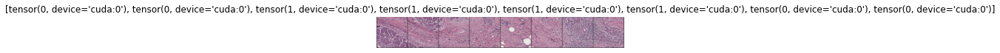

113
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


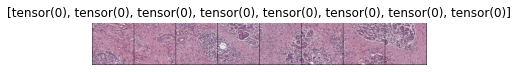

Prediction:


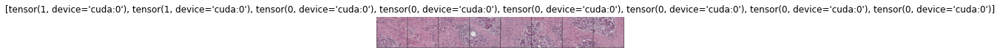

114
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


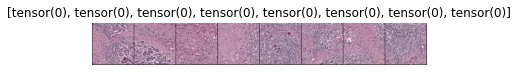

Prediction:


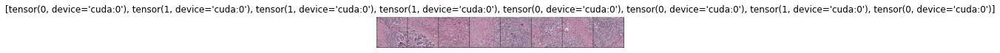

115
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


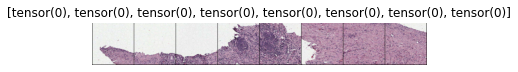

Prediction:


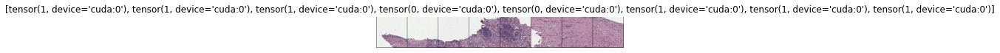

116
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


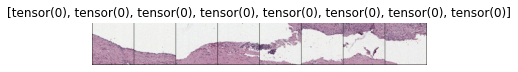

Prediction:


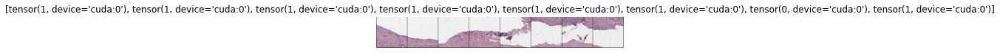

117
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


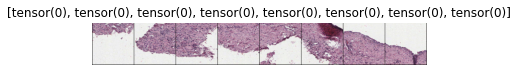

Prediction:


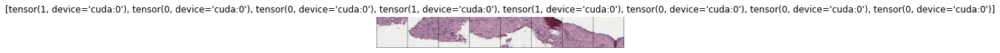

118
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


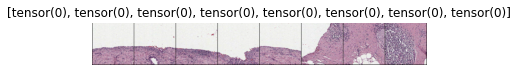

Prediction:


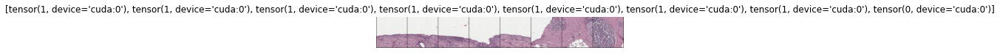

119
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


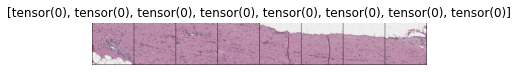

Prediction:


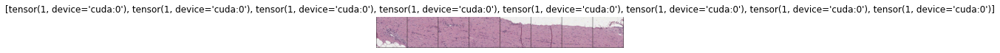

120
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


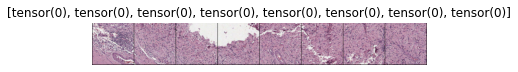

Prediction:


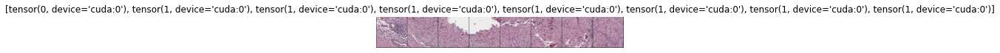

121
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


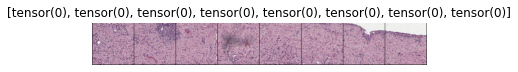

Prediction:


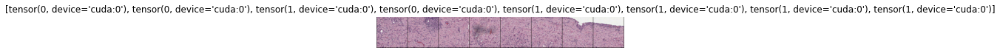

122
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


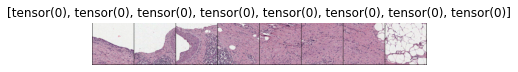

Prediction:


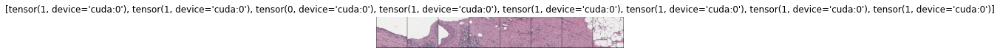

123
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


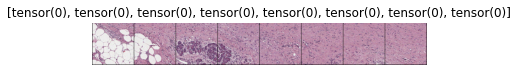

Prediction:


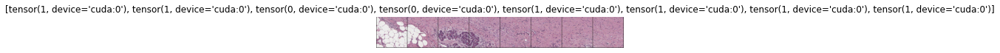

124
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


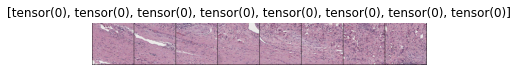

Prediction:


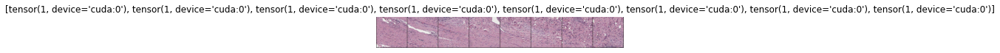

125
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


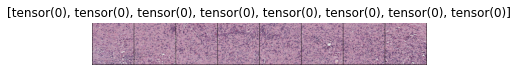

Prediction:


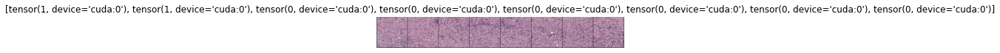

126
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


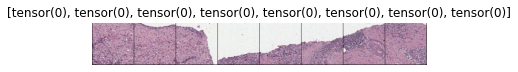

Prediction:


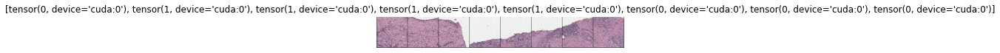

127
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


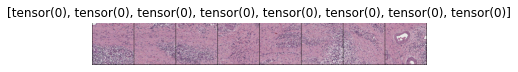

Prediction:


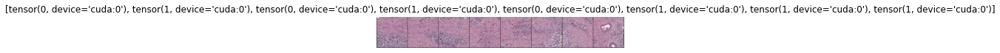

128
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


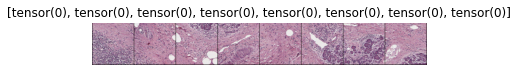

Prediction:


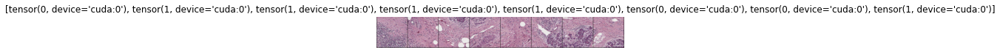

129
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


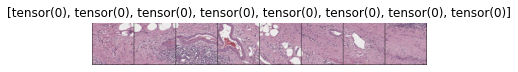

Prediction:


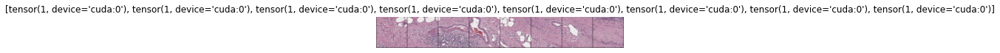

130
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


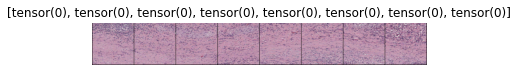

Prediction:


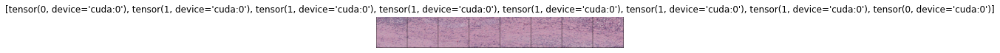

131
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


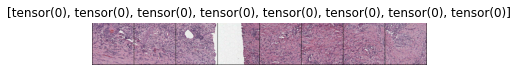

Prediction:


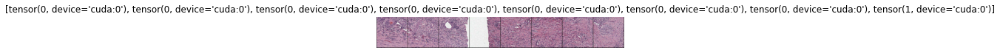

132
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


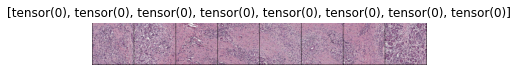

Prediction:


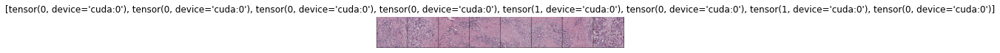

133
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


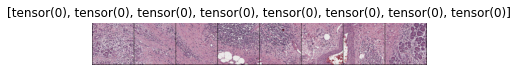

Prediction:


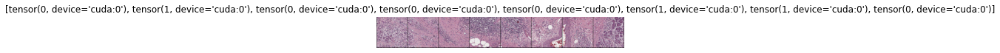

134
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


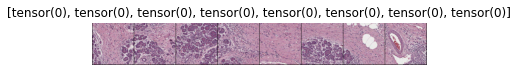

Prediction:


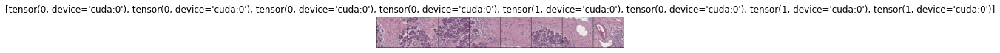

135
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


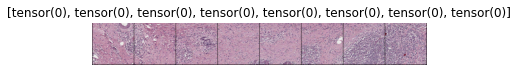

Prediction:


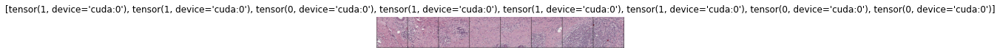

136
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


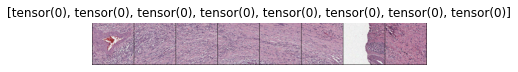

Prediction:


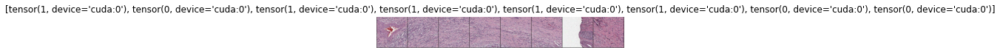

137
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


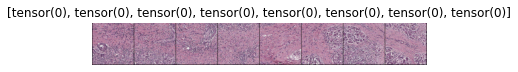

Prediction:


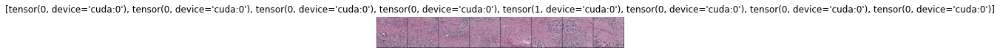

138
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


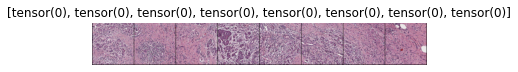

Prediction:


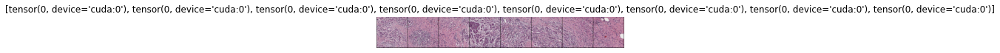

139
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


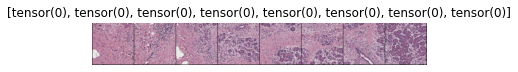

Prediction:


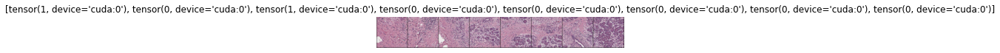

140
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


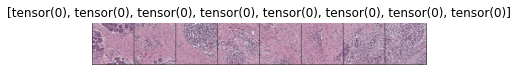

Prediction:


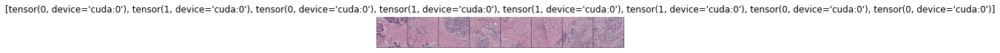

141
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


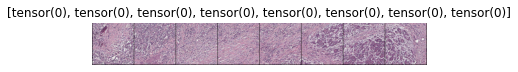

Prediction:


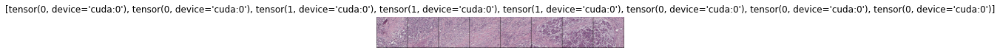

142
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


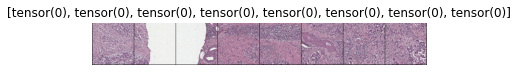

Prediction:


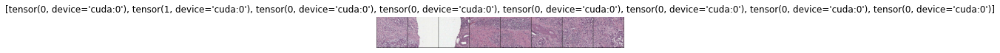

143
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


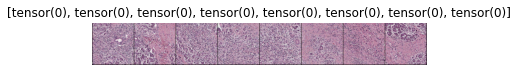

Prediction:


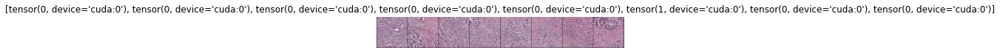

144
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


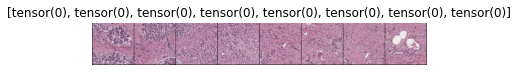

Prediction:


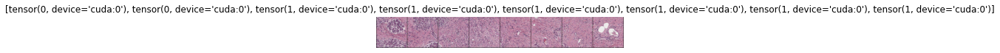

145
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


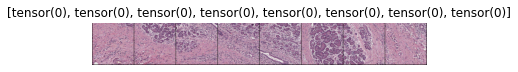

Prediction:


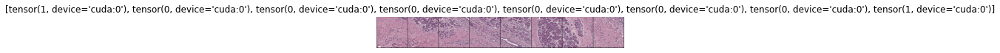

146
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


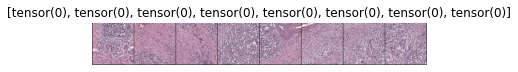

Prediction:


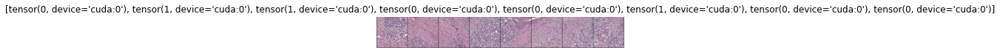

147
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


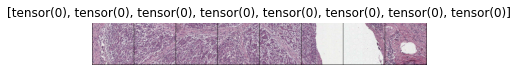

Prediction:


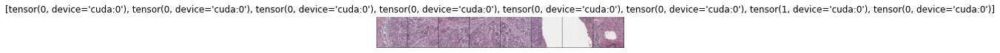

148
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


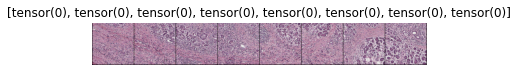

Prediction:


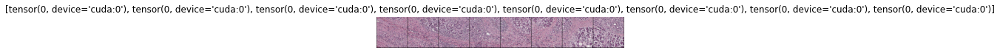

149
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


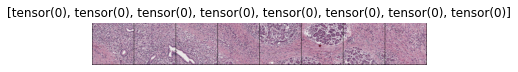

Prediction:


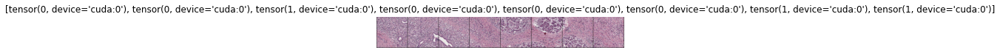

150
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


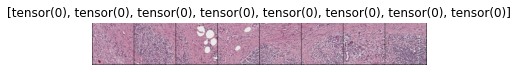

Prediction:


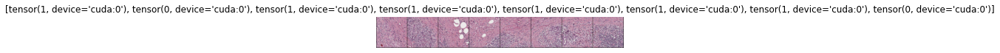

151
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


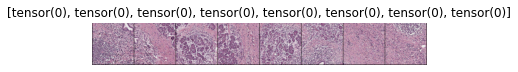

Prediction:


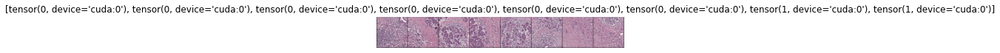

152
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


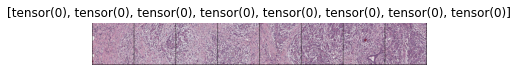

Prediction:


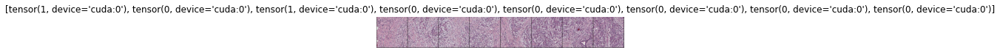

153
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


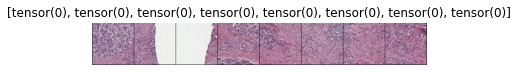

Prediction:


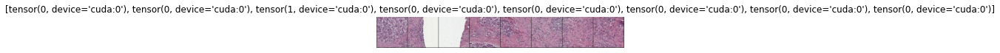

154
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


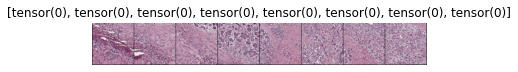

Prediction:


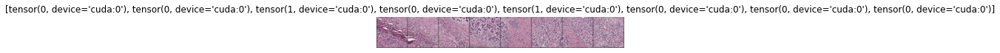

155
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


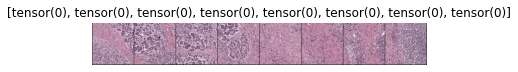

Prediction:


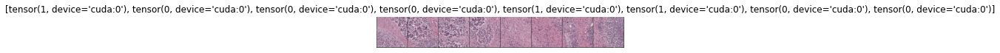

156
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


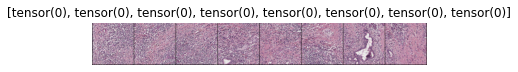

Prediction:


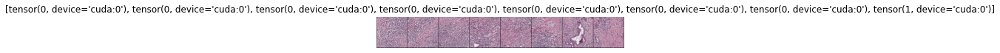

157
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


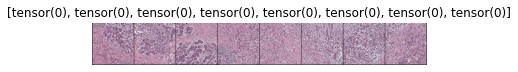

Prediction:


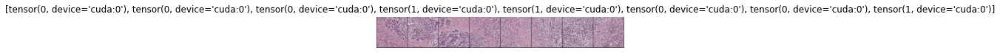

158
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


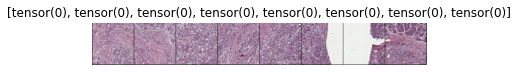

Prediction:


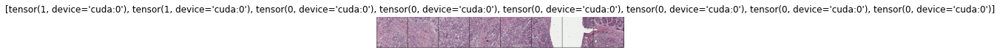

159
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


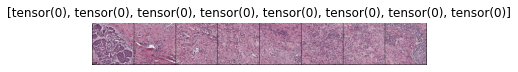

Prediction:


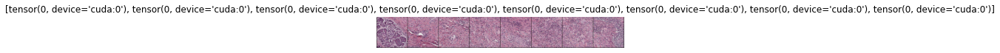

160
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


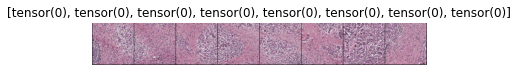

Prediction:


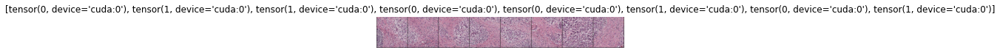

161
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '0', '0', '0', '0', '0', '0', '0')
Ground truth:


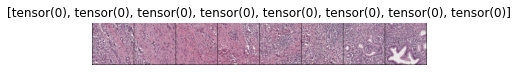

Prediction:


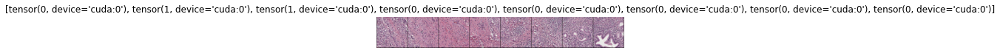

162
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('0', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


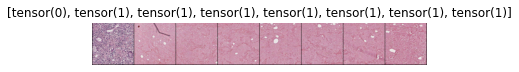

Prediction:


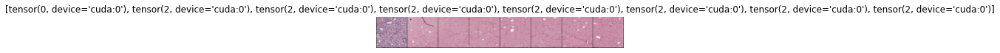

163
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


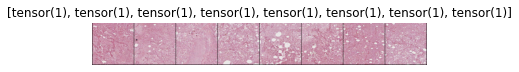

Prediction:


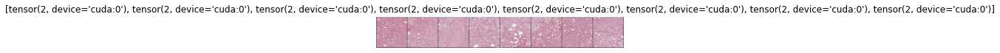

164
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


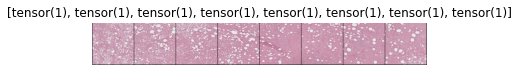

Prediction:


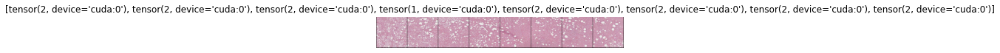

165
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


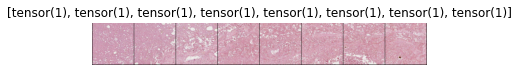

Prediction:


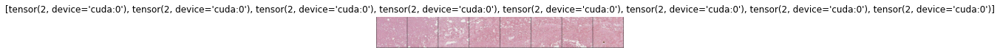

166
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


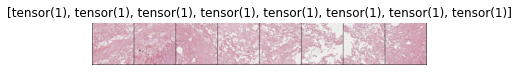

Prediction:


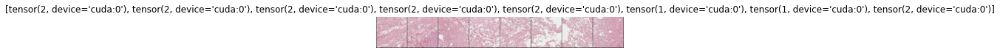

167
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


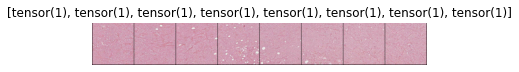

Prediction:


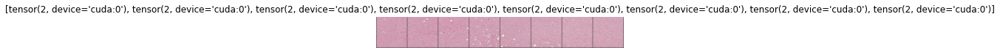

168
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


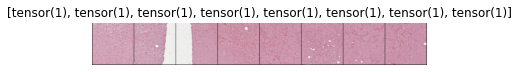

Prediction:


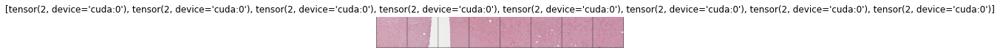

169
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


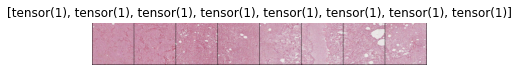

Prediction:


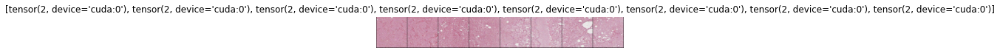

170
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


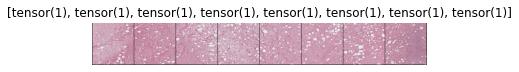

Prediction:


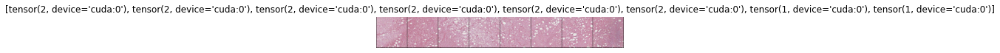

171
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


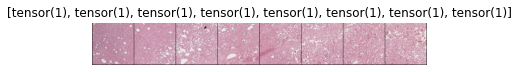

Prediction:


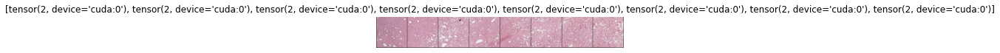

172
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


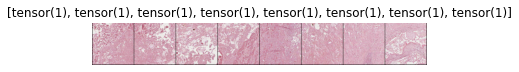

Prediction:


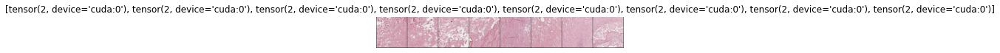

173
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


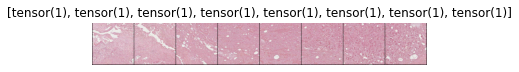

Prediction:


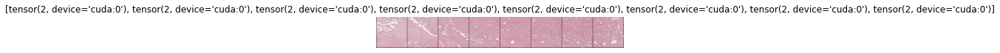

174
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


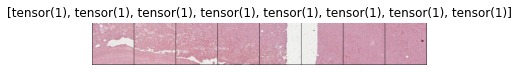

Prediction:


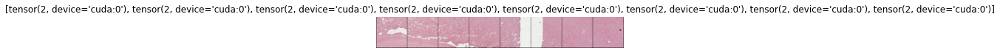

175
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


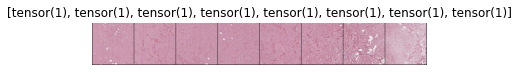

Prediction:


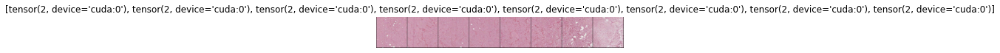

176
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


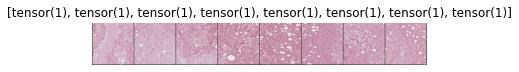

Prediction:


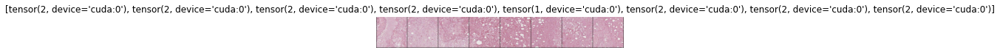

177
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


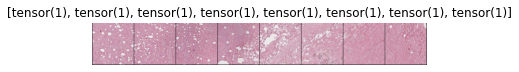

Prediction:


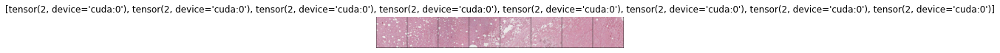

178
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


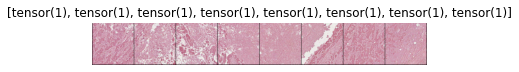

Prediction:


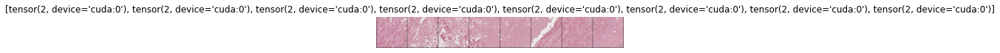

179
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


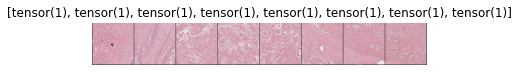

Prediction:


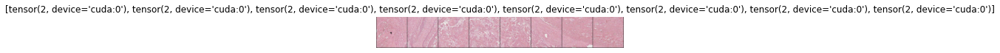

180
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


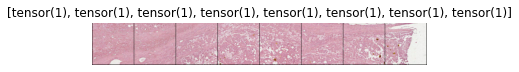

Prediction:


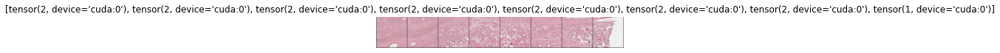

181
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


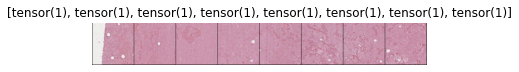

Prediction:


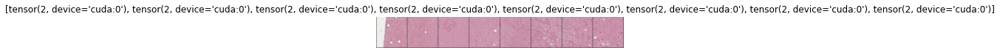

182
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


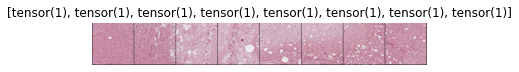

Prediction:


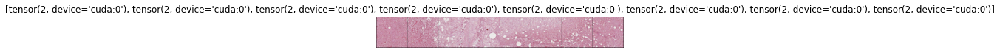

183
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


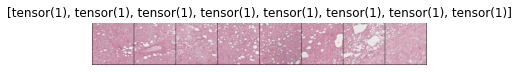

Prediction:


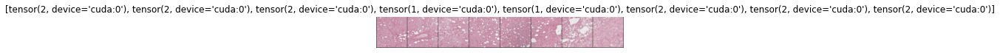

184
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


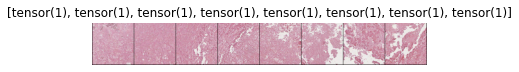

Prediction:


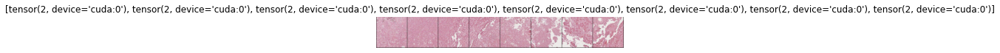

185
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


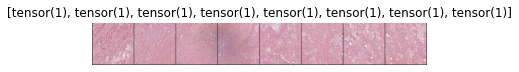

Prediction:


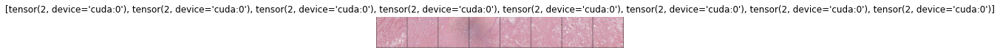

186
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


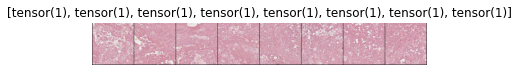

Prediction:


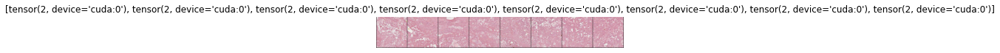

187
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


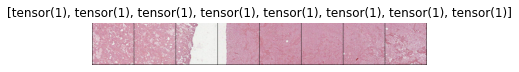

Prediction:


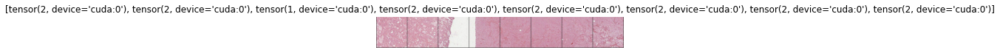

188
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


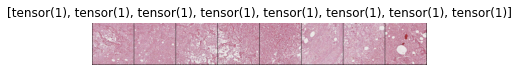

Prediction:


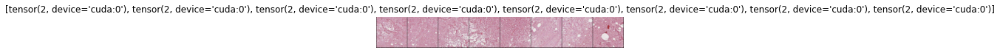

189
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


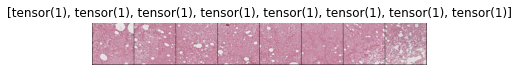

Prediction:


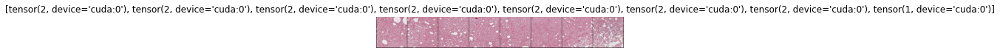

190
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


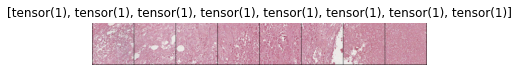

Prediction:


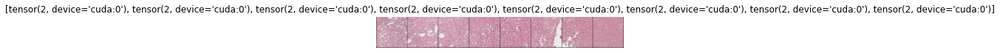

191
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


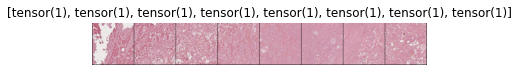

Prediction:


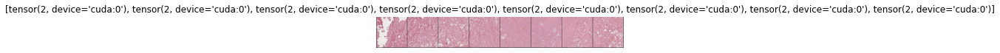

192
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


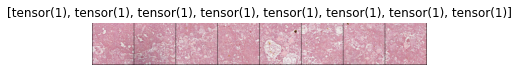

Prediction:


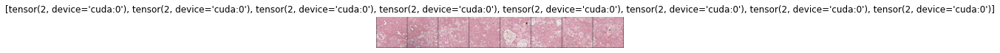

193
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


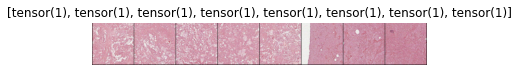

Prediction:


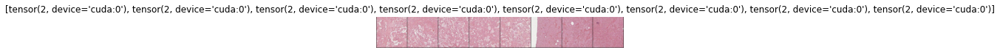

194
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


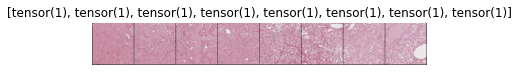

Prediction:


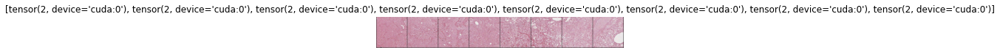

195
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


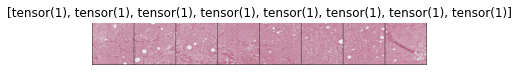

Prediction:


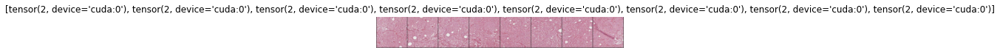

196
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


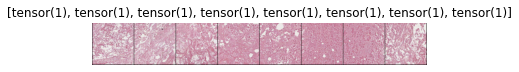

Prediction:


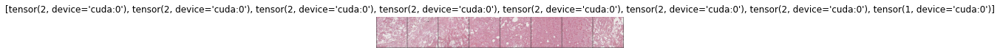

197
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


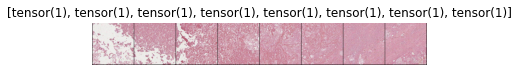

Prediction:


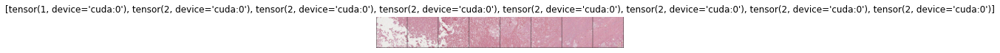

198
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


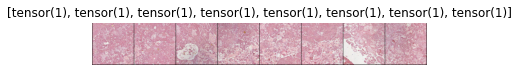

Prediction:


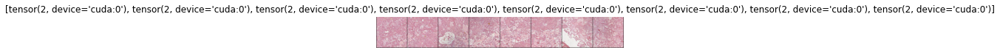

199
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


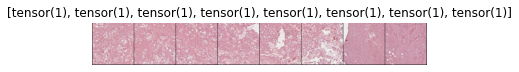

Prediction:


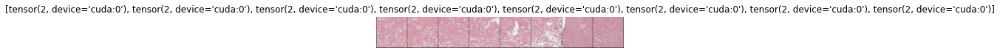

200
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


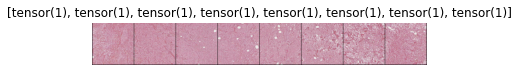

Prediction:


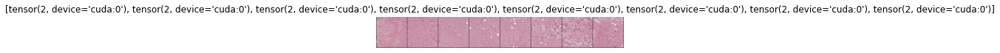

201
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


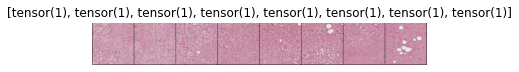

Prediction:


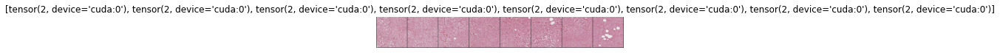

202
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


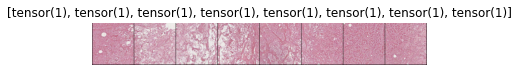

Prediction:


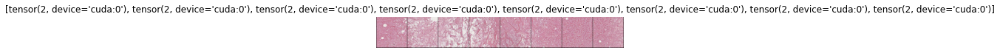

203
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


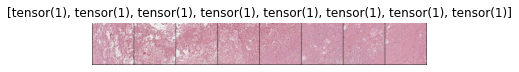

Prediction:


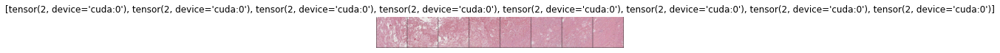

204
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


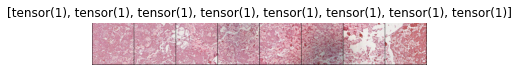

Prediction:


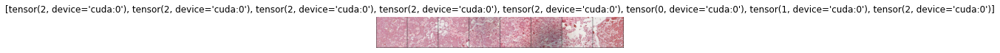

205
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


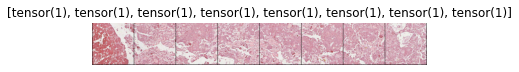

Prediction:


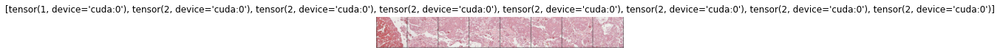

206
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


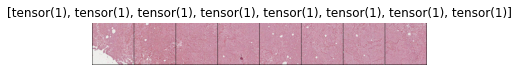

Prediction:


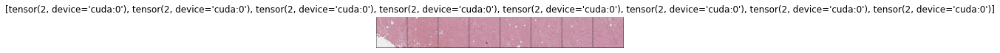

207
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


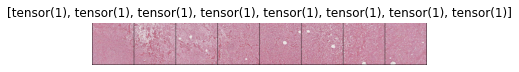

Prediction:


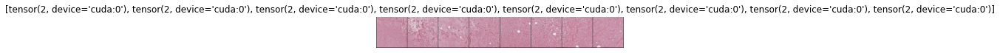

208
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


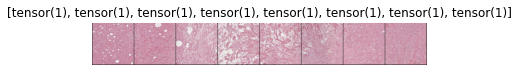

Prediction:


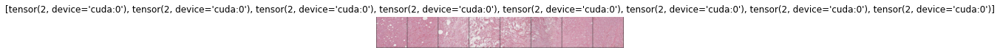

209
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


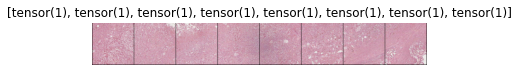

Prediction:


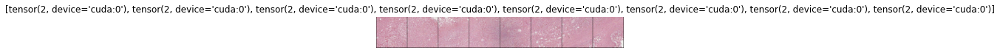

210
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


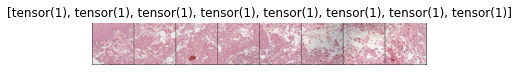

Prediction:


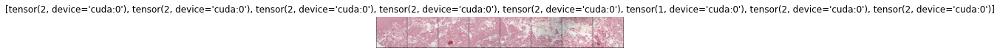

211
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


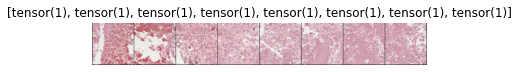

Prediction:


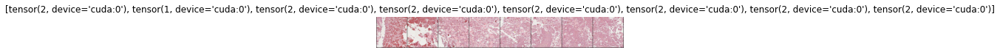

212
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


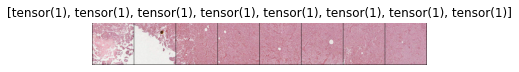

Prediction:


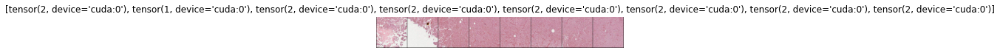

213
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


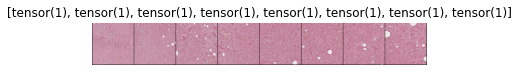

Prediction:


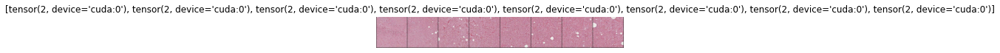

214
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


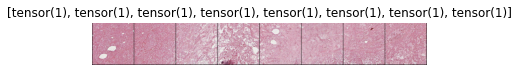

Prediction:


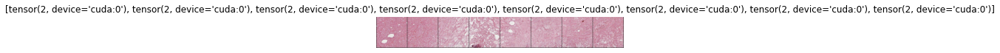

215
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


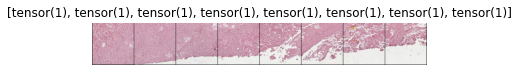

Prediction:


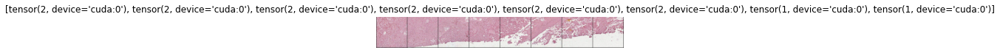

216
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


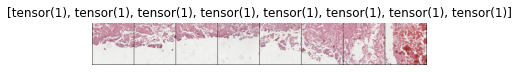

Prediction:


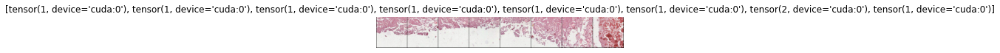

217
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


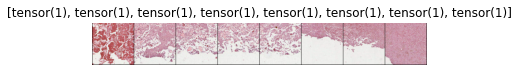

Prediction:


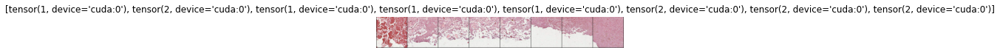

218
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


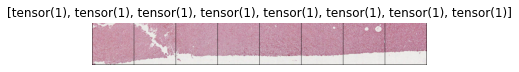

Prediction:


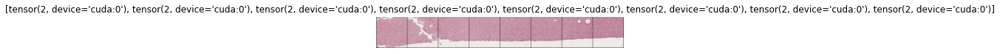

219
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


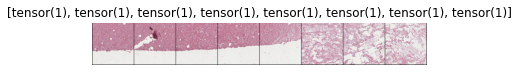

Prediction:


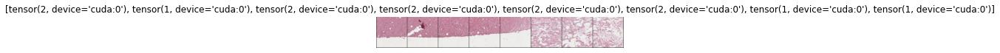

220
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


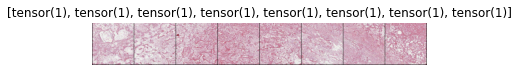

Prediction:


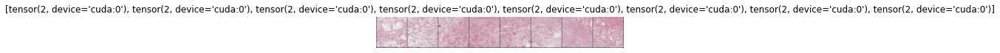

221
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


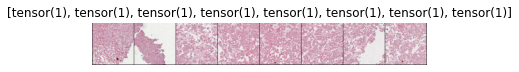

Prediction:


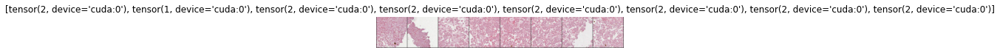

222
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


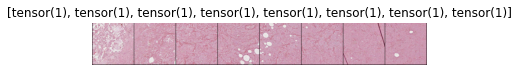

Prediction:


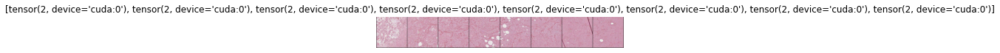

223
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


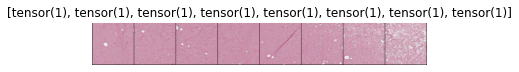

Prediction:


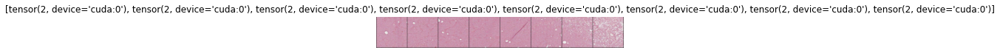

224
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


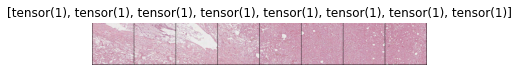

Prediction:


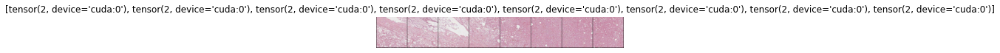

225
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


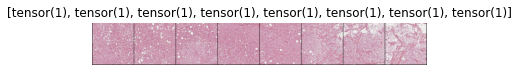

Prediction:


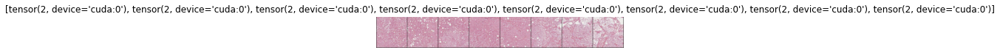

226
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


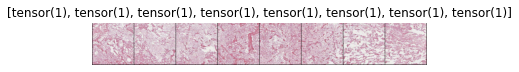

Prediction:


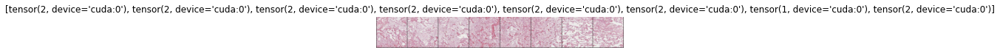

227
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


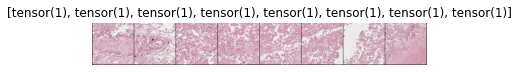

Prediction:


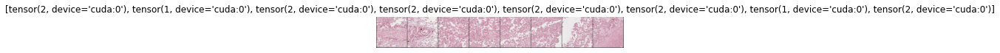

228
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


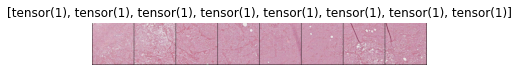

Prediction:


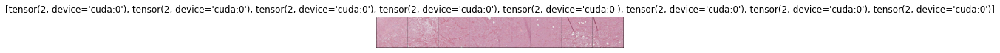

229
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


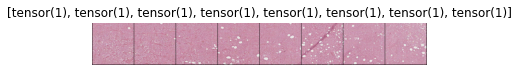

Prediction:


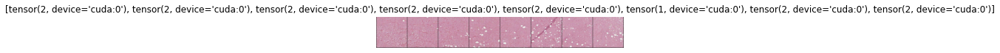

230
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


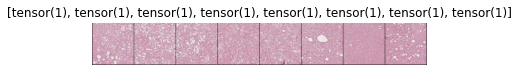

Prediction:


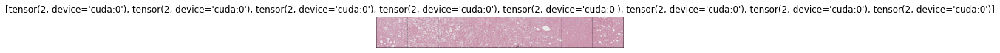

231
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


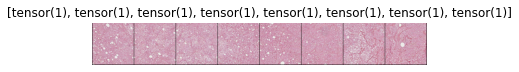

Prediction:


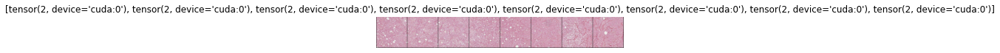

232
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


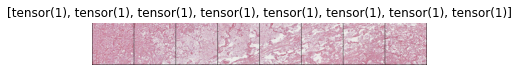

Prediction:


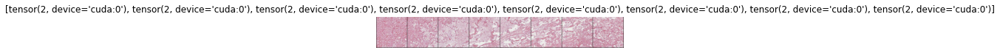

233
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


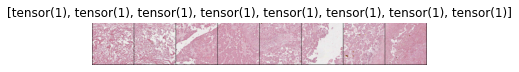

Prediction:


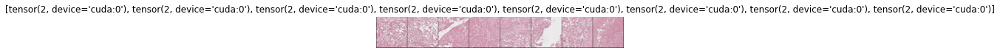

234
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


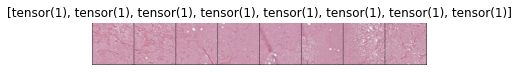

Prediction:


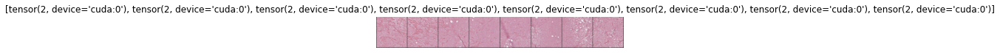

235
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


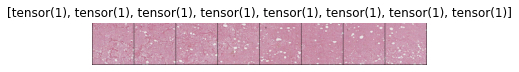

Prediction:


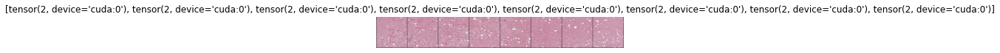

236
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


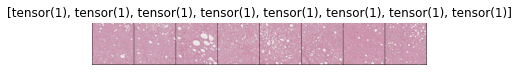

Prediction:


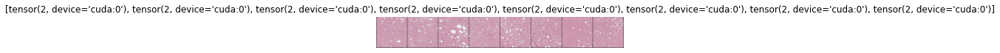

237
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


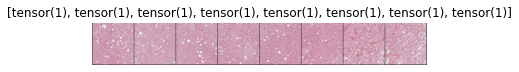

Prediction:


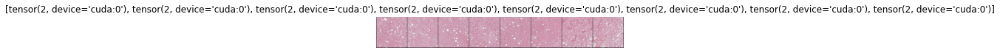

238
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


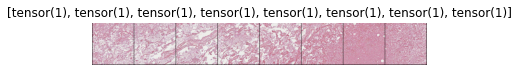

Prediction:


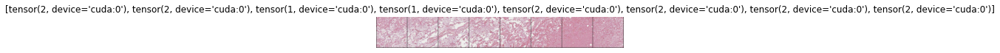

239
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


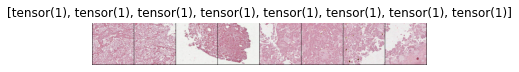

Prediction:


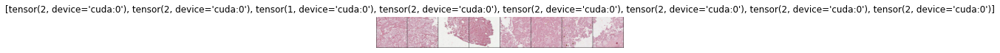

240
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


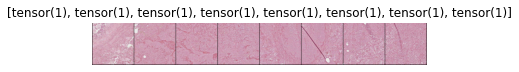

Prediction:


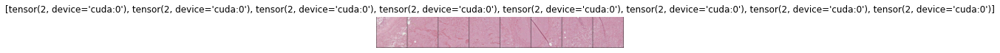

241
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


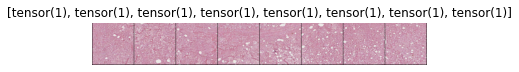

Prediction:


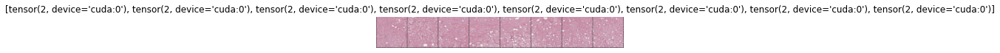

242
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


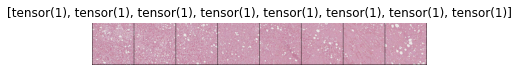

Prediction:


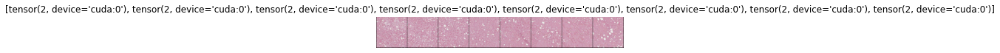

243
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


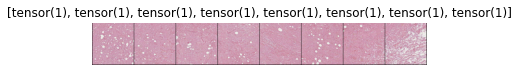

Prediction:


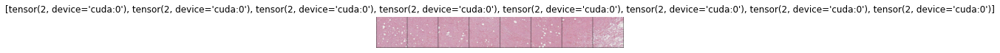

244
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


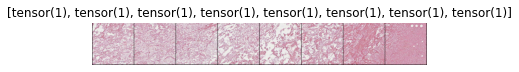

Prediction:


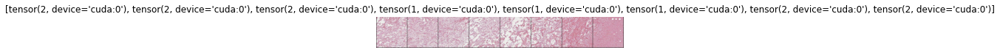

245
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


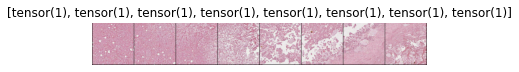

Prediction:


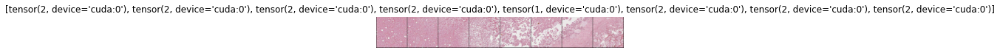

246
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


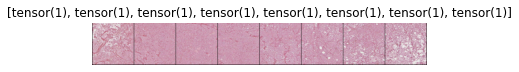

Prediction:


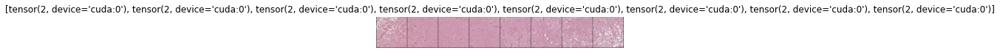

247
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


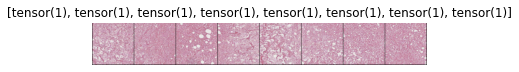

Prediction:


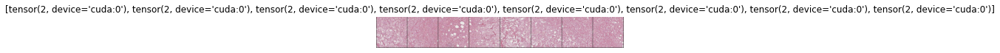

248
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


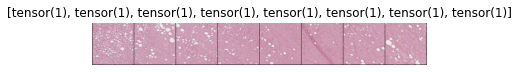

Prediction:


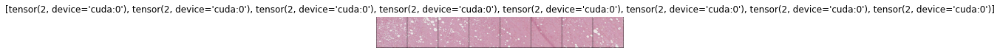

249
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


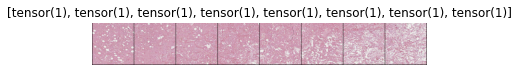

Prediction:


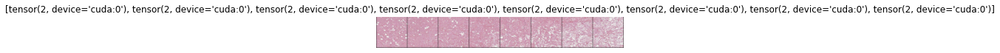

250
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


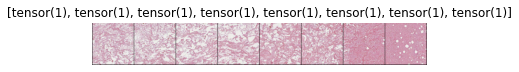

Prediction:


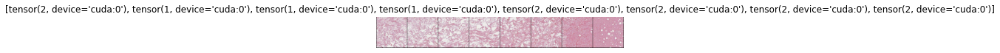

251
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


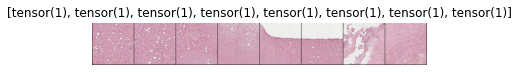

Prediction:


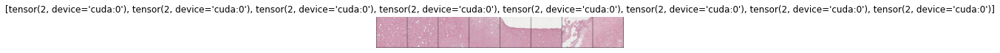

252
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


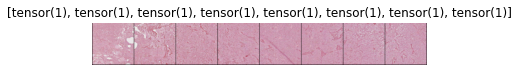

Prediction:


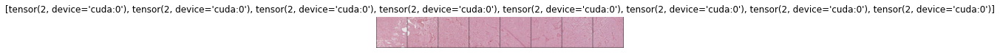

253
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


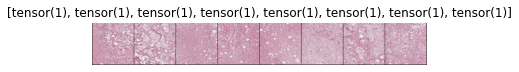

Prediction:


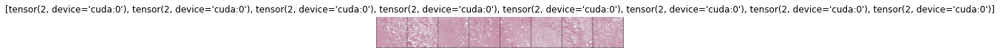

254
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


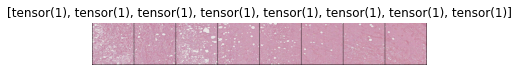

Prediction:


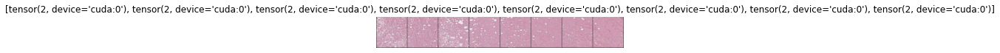

255
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


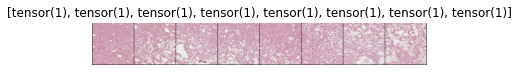

Prediction:


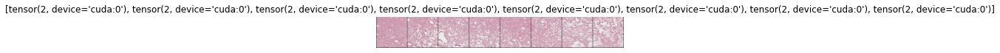

256
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


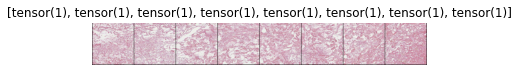

Prediction:


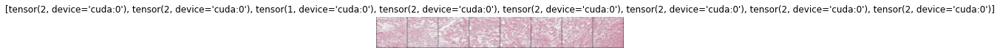

257
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


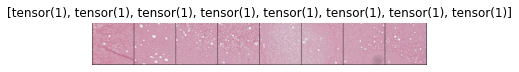

Prediction:


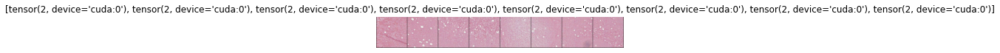

258
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


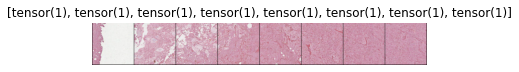

Prediction:


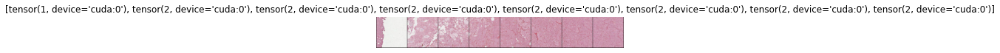

259
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


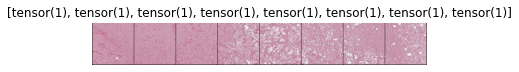

Prediction:


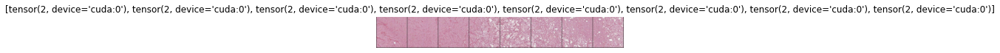

260
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


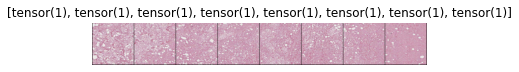

Prediction:


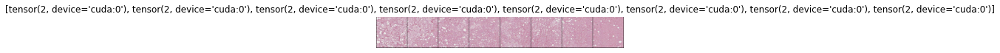

261
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


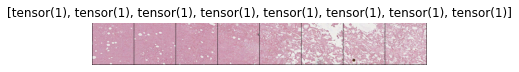

Prediction:


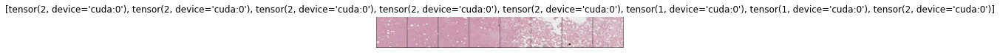

262
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


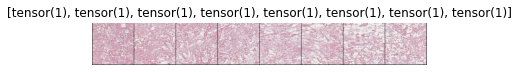

Prediction:


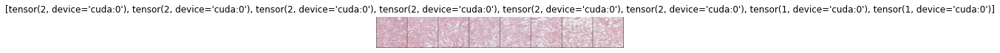

263
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


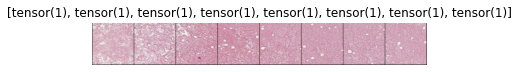

Prediction:


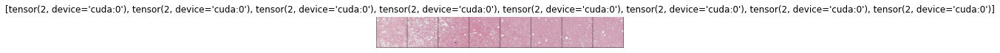

264
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


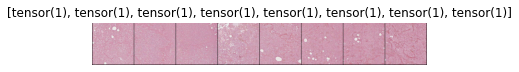

Prediction:


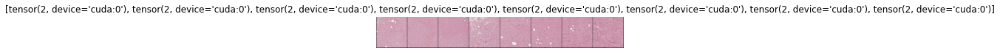

265
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


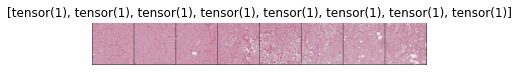

Prediction:


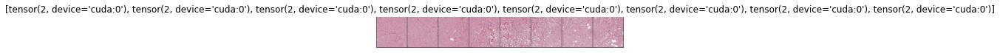

266
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


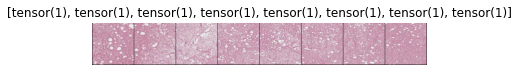

Prediction:


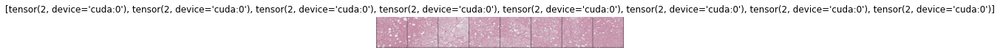

267
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


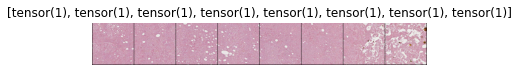

Prediction:


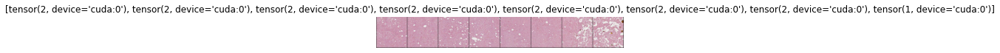

268
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


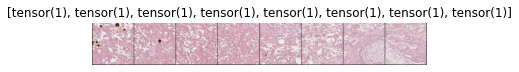

Prediction:


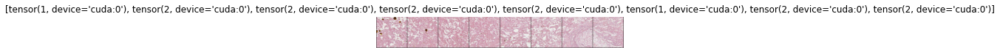

269
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


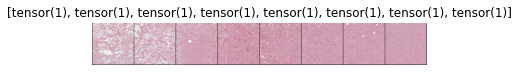

Prediction:


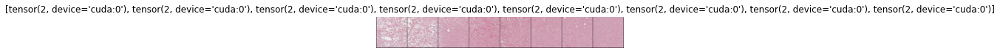

270
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


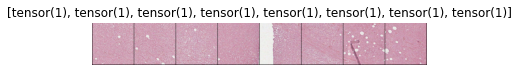

Prediction:


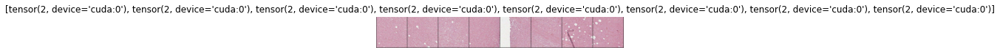

271
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


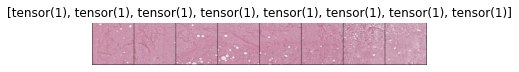

Prediction:


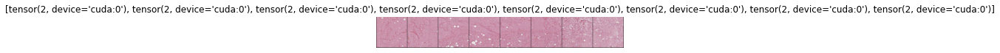

272
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


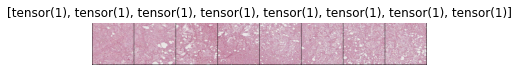

Prediction:


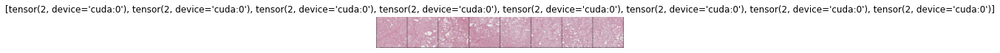

273
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


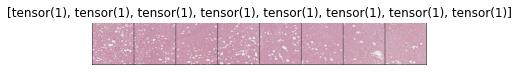

Prediction:


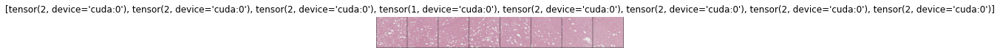

274
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


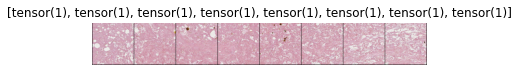

Prediction:


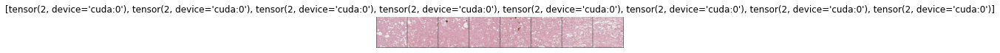

275
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


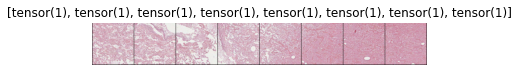

Prediction:


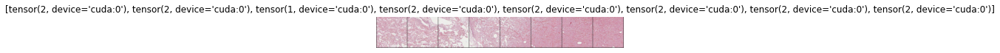

276
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


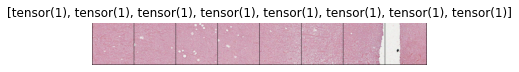

Prediction:


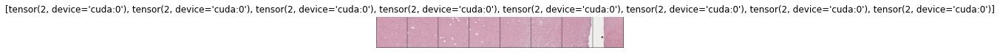

277
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


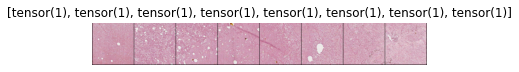

Prediction:


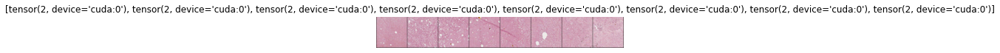

278
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


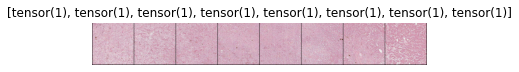

Prediction:


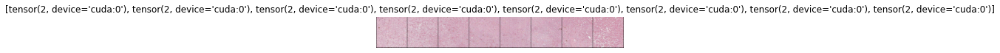

279
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


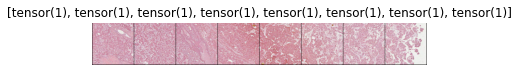

Prediction:


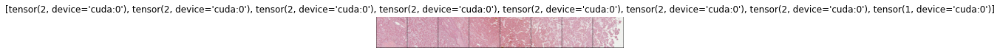

280
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


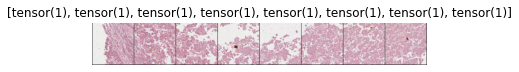

Prediction:


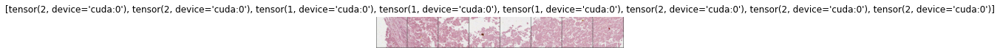

281
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


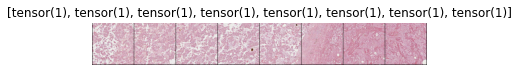

Prediction:


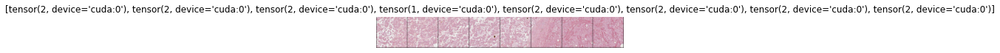

282
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


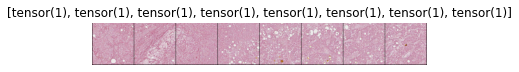

Prediction:


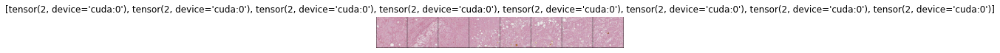

283
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


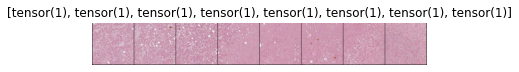

Prediction:


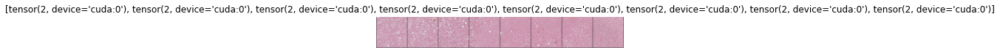

284
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


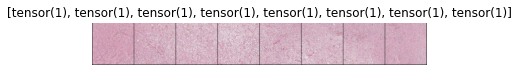

Prediction:


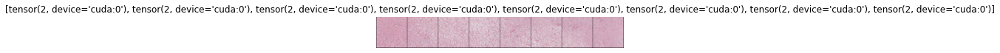

285
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


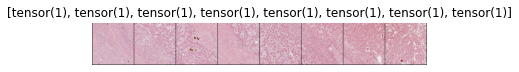

Prediction:


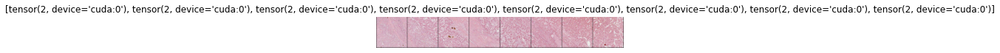

286
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


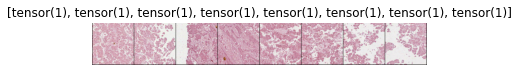

Prediction:


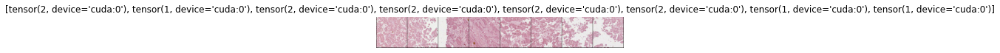

287
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


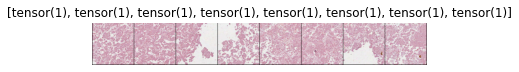

Prediction:


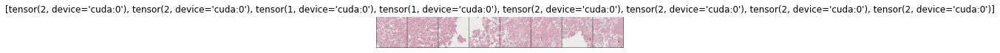

288
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


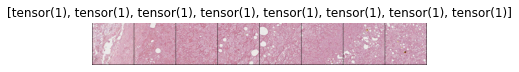

Prediction:


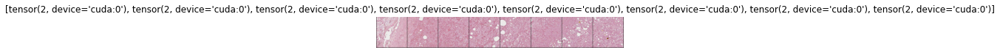

289
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


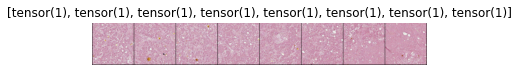

Prediction:


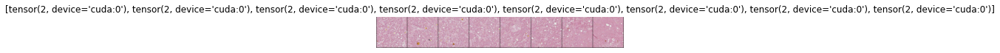

290
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


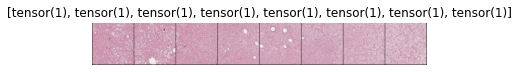

Prediction:


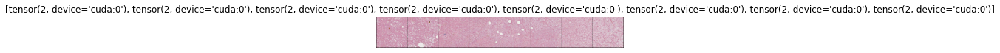

291
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


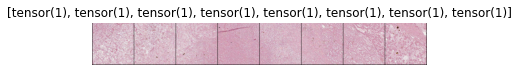

Prediction:


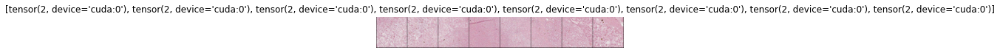

292
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


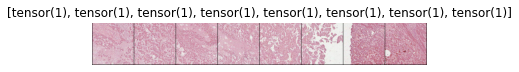

Prediction:


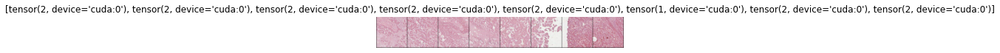

293
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


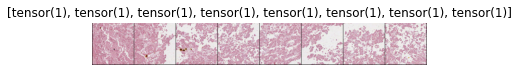

Prediction:


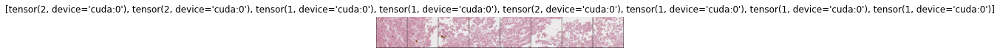

294
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


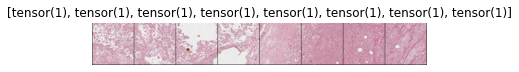

Prediction:


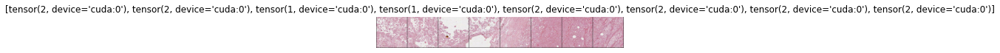

295
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


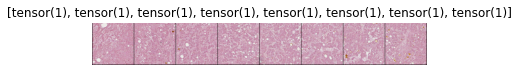

Prediction:


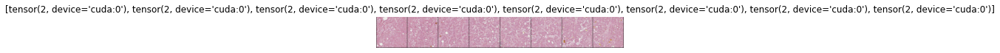

296
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


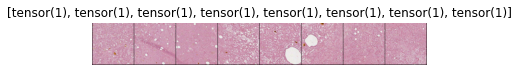

Prediction:


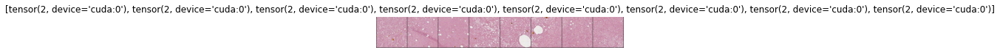

297
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


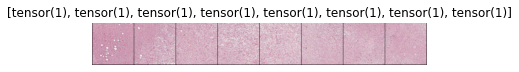

Prediction:


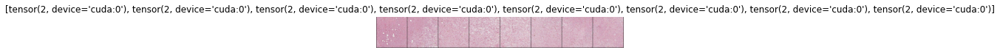

298
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


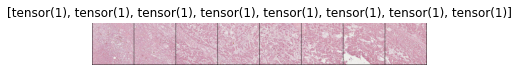

Prediction:


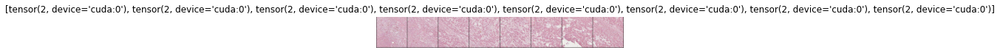

299
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


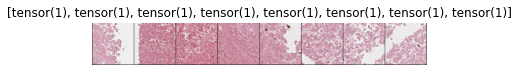

Prediction:


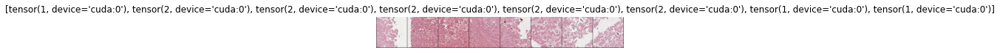

300
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


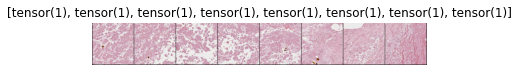

Prediction:


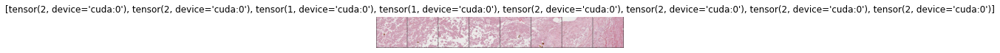

301
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


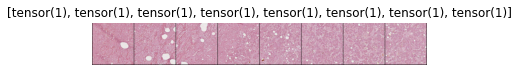

Prediction:


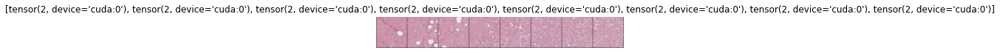

302
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


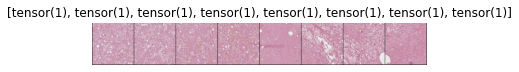

Prediction:


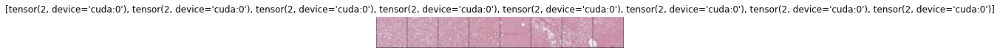

303
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


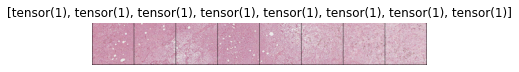

Prediction:


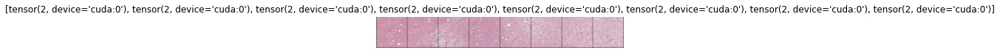

304
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


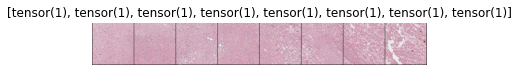

Prediction:


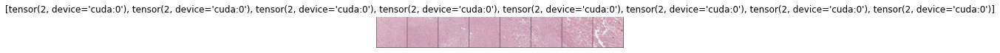

305
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


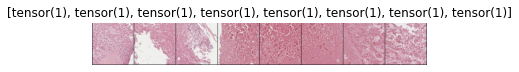

Prediction:


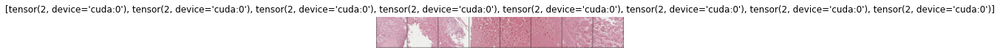

306
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


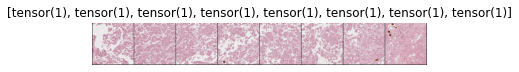

Prediction:


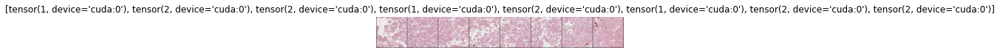

307
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


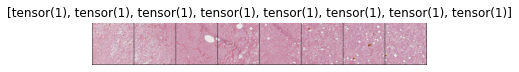

Prediction:


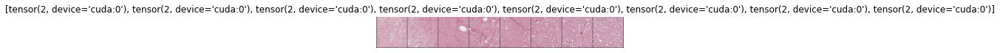

308
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


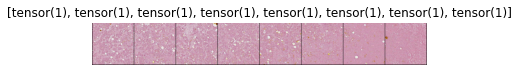

Prediction:


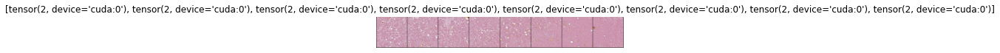

309
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


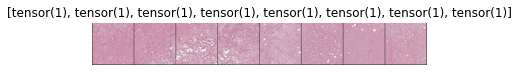

Prediction:


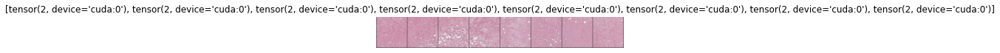

310
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


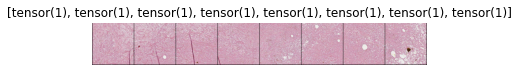

Prediction:


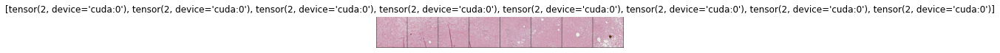

311
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


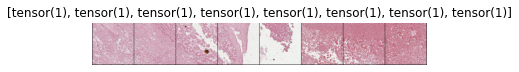

Prediction:


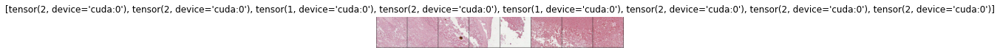

312
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


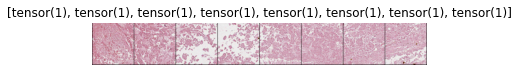

Prediction:


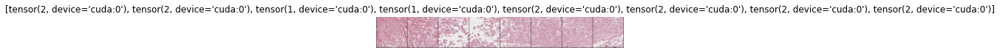

313
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


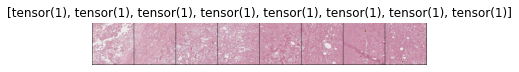

Prediction:


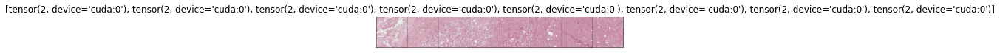

314
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


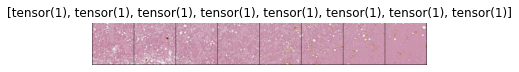

Prediction:


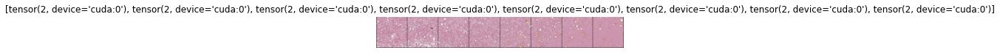

315
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


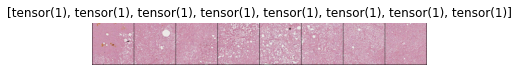

Prediction:


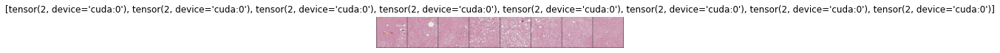

316
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


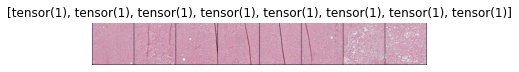

Prediction:


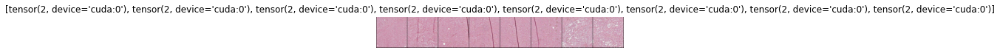

317
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


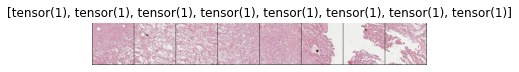

Prediction:


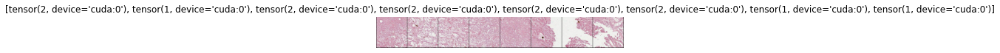

318
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


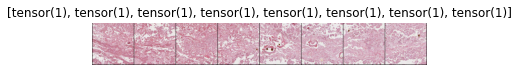

Prediction:


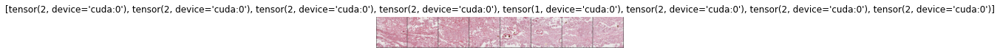

319
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


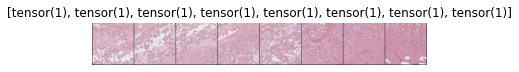

Prediction:


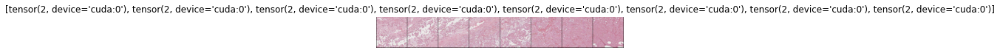

320
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


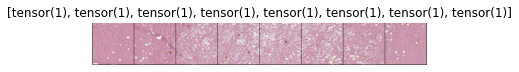

Prediction:


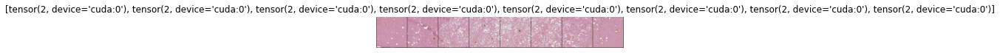

321
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


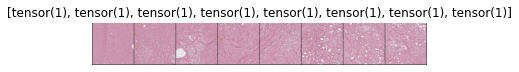

Prediction:


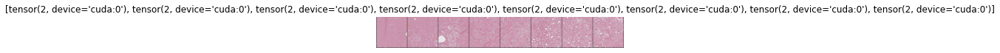

322
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


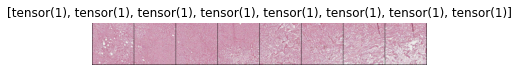

Prediction:


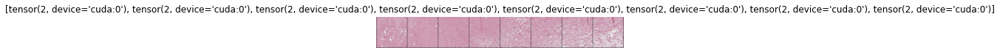

323
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


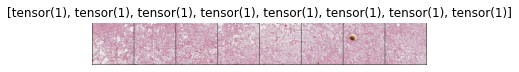

Prediction:


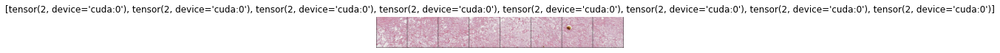

324
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


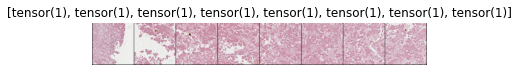

Prediction:


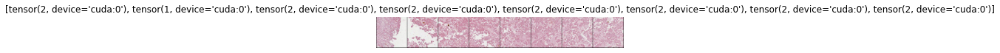

325
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


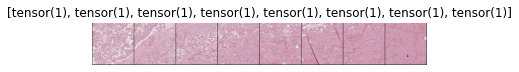

Prediction:


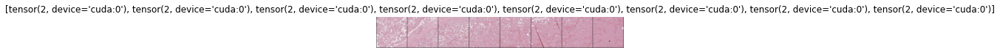

326
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


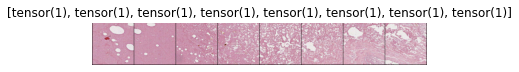

Prediction:


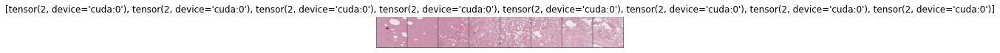

327
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


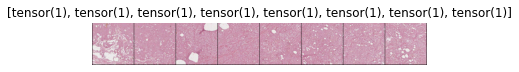

Prediction:


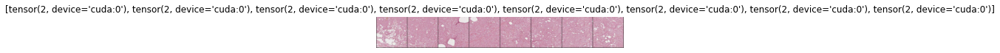

328
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


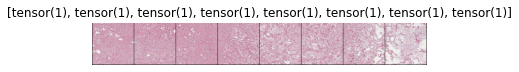

Prediction:


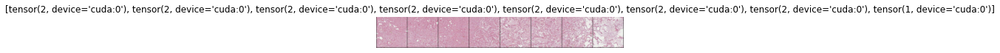

329
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


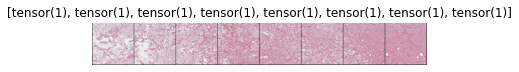

Prediction:


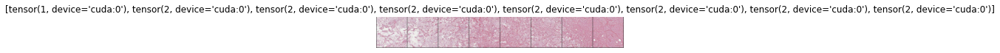

330
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


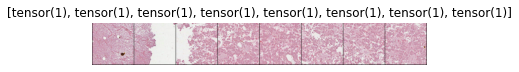

Prediction:


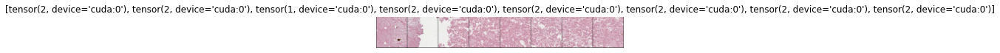

331
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


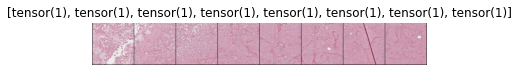

Prediction:


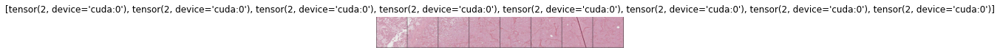

332
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


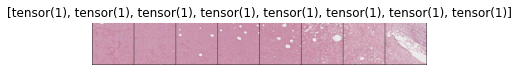

Prediction:


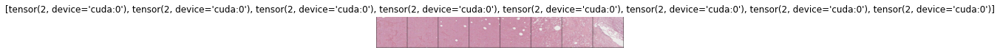

333
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


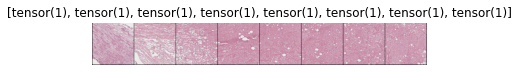

Prediction:


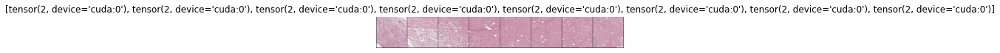

334
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


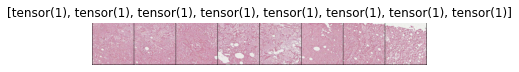

Prediction:


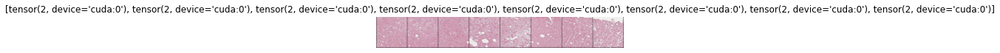

335
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


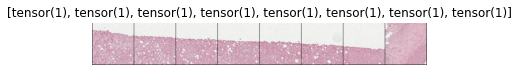

Prediction:


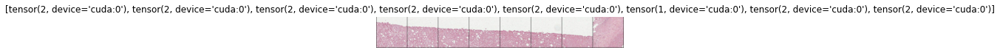

336
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


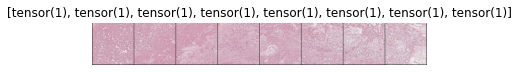

Prediction:


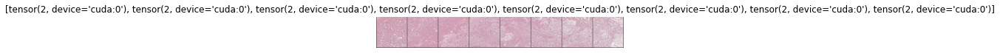

337
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


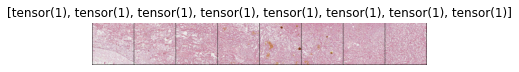

Prediction:


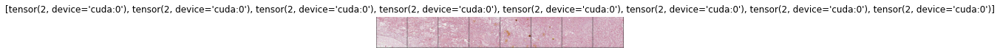

338
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


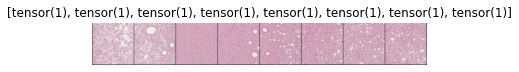

Prediction:


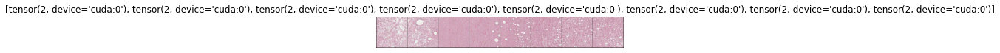

339
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


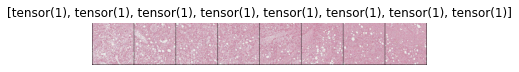

Prediction:


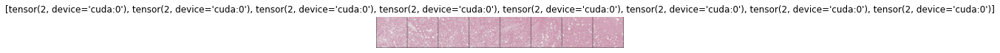

340
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


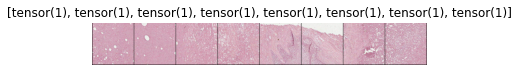

Prediction:


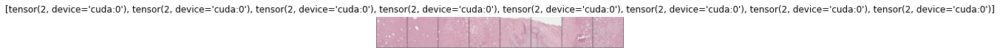

341
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


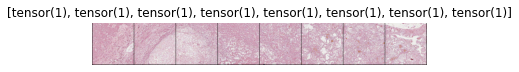

Prediction:


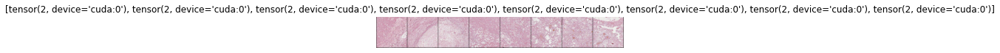

342
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


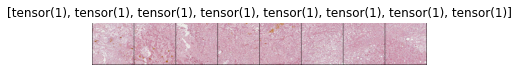

Prediction:


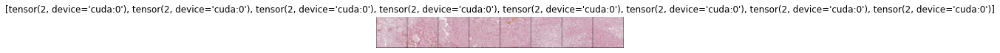

343
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


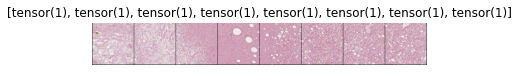

Prediction:


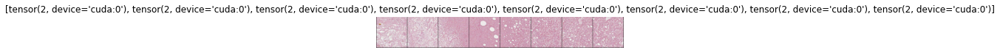

344
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


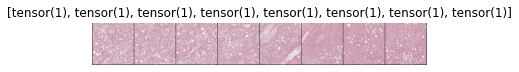

Prediction:


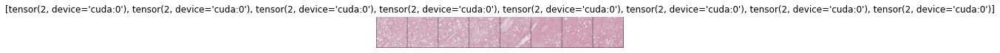

345
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


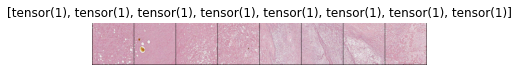

Prediction:


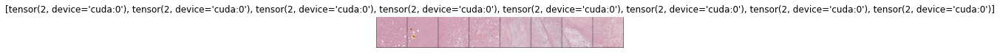

346
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


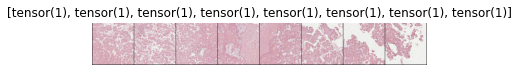

Prediction:


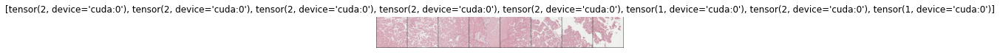

347
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


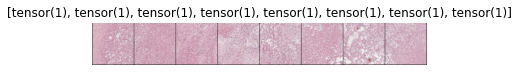

Prediction:


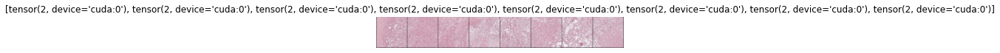

348
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


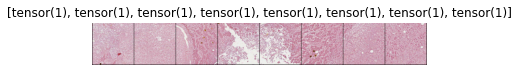

Prediction:


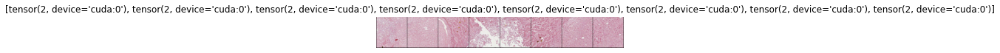

349
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


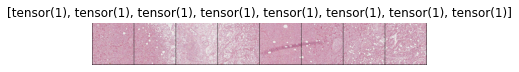

Prediction:


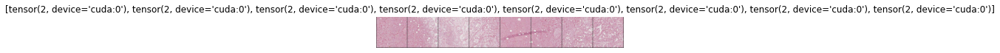

350
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


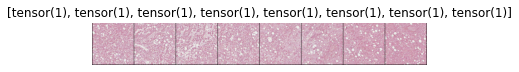

Prediction:


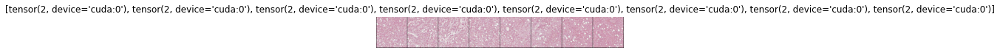

351
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


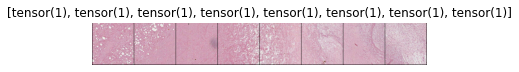

Prediction:


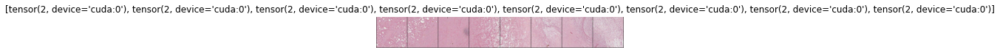

352
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


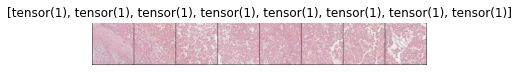

Prediction:


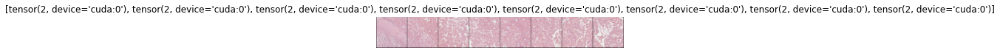

353
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


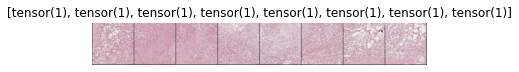

Prediction:


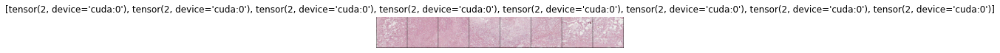

354
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


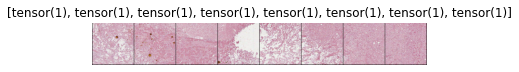

Prediction:


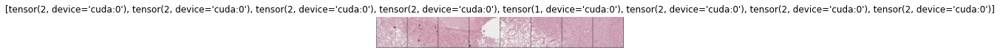

355
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


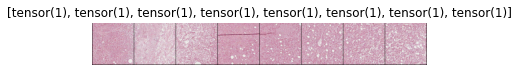

Prediction:


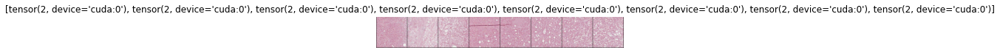

356
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


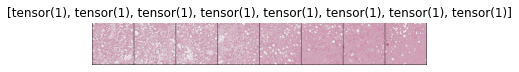

Prediction:


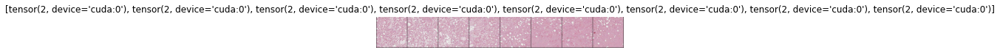

357
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


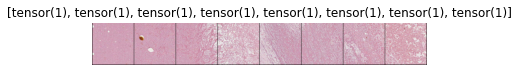

Prediction:


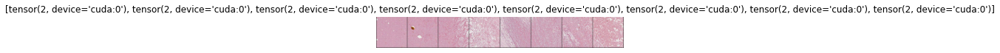

358
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


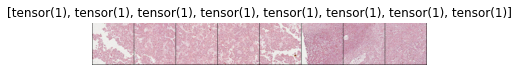

Prediction:


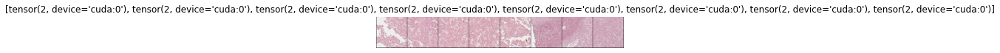

359
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


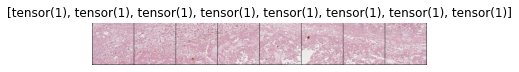

Prediction:


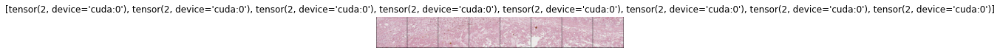

360
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


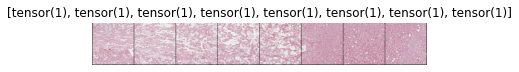

Prediction:


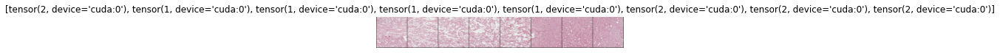

361
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


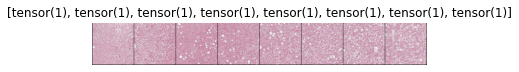

Prediction:


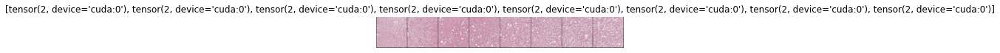

362
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


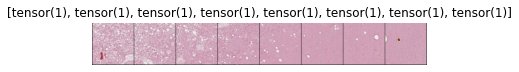

Prediction:


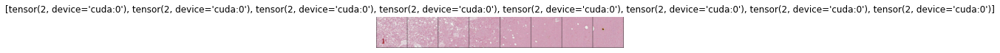

363
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


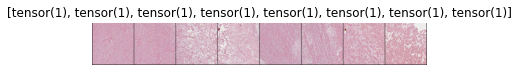

Prediction:


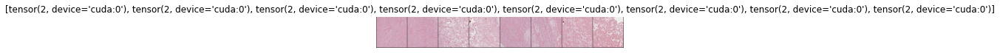

364
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


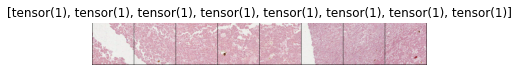

Prediction:


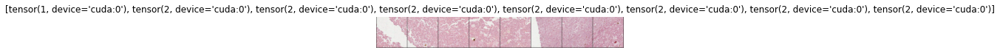

365
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


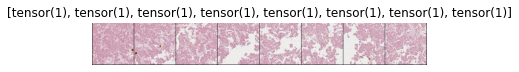

Prediction:


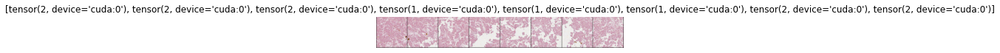

366
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


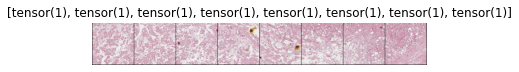

Prediction:


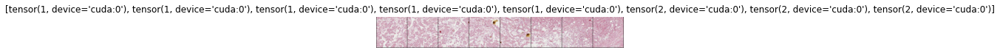

367
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


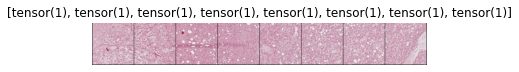

Prediction:


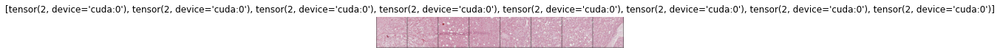

368
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


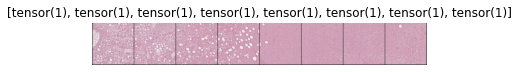

Prediction:


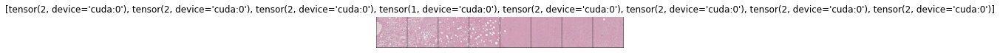

369
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


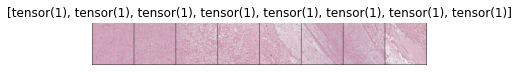

Prediction:


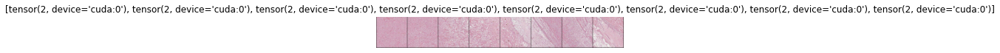

370
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


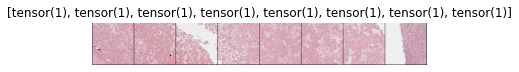

Prediction:


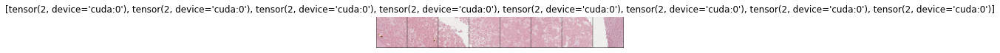

371
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


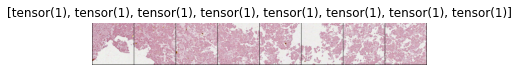

Prediction:


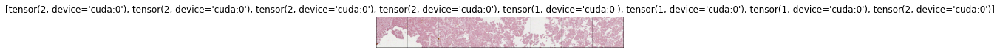

372
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


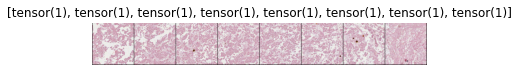

Prediction:


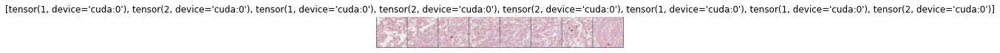

373
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


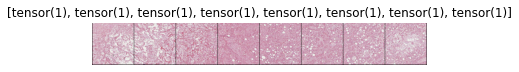

Prediction:


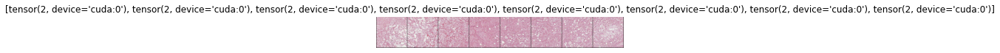

374
input  <bound method Kernel.raw_input of <google.colab._kernel.Kernel object at 0x7fd0f5ab6208>>
labels  ('1', '1', '1', '1', '1', '1', '1', '1')
Ground truth:


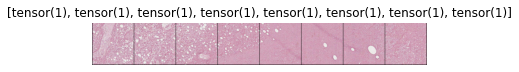

Prediction:


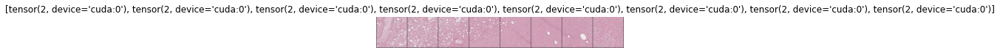

375

In [24]:
visualize_model(vgg16, num_images=3000)

In [26]:
eval_model(vgg16, criterion)

Evaluating model
----------
Test batch 0/629

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:23: UserWarning: volatile was removed and now has no effect. Use `with torch.no_grad():` instead.


Test batch 600/629
Evaluation completed in 4m 6s
Avg loss (test): 2.4880
Avg acc (test): 1.7250
----------


(1603609141.2632852,
 tensor(1564.9270, device='cuda:0'),
 tensor(1085, device='cuda:0'))